In [2]:
import os
from glob import glob
import pandas as pd
import numpy as np
import missingno as msno
import seaborn as sns
import matplotlib.pyplot as plt  
from prophet import Prophet
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [3]:
current_dir = os.getcwd()
current_dir

'/Users/meylianisanjaya/Desktop/Capstone-4850/Industrial/timeSeries_dataset'

Load Dataset

In [4]:
# Create an empty dictionary
dataframes = {}

# Loop through each subfolder
for folder_name in os.listdir(current_dir):
    folder_path = os.path.join(current_dir, folder_name)
    
    if os.path.isdir(folder_path):
        # Find all .csv files
        csv_files = glob(os.path.join(folder_path, '*.csv'))

        # Concatenate all files into one DataFrame
        if csv_files:
            df = pd.concat([pd.read_csv(f) for f in csv_files], ignore_index=True)
            dataframes[folder_name] = df
            print(f"Loaded {folder_name}: {df.shape}")
        else:
            print(f"No part-*.csv files found in {folder_name}")

Loaded parksClassifications: (254, 6)
Loaded weatherVancouver: (9335, 27)
Loaded parksID: (68, 6)
No part-*.csv files found in .venv
Loaded NDVI: (99822, 9)
No part-*.csv files found in .vscode
Loaded parksLiveTimes: (386471, 3)
No part-*.csv files found in pyenv_project


Display Dataframe

In [5]:
print(dataframes.keys())

# Display the first few rows of each DataFrame
for name, df in dataframes.items():
    print(f"\n DataFrame: {name} — shape: {df.shape}")
    display(df.head())

dict_keys(['parksClassifications', 'weatherVancouver', 'parksID', 'NDVI', 'parksLiveTimes'])

 DataFrame: parksClassifications — shape: (254, 6)


,park_name,Classification,placeID,parkSize,Pop/ha,Bus Stop/ha
0,Andy Livingstone Park,Community,ChIJFRGrHHtxhlQRAZVZlqaROSw,42162.060250,146.488081,0.314740
1,Arbutus Greenway Park,Neighbourhood,ChIJF391QrBzhlQRw86A7fL1egg,6887.417942,88.211859,0.131638
2,Bobolink Park,Neighbourhood,ChIJTU9RhTJ0hlQReT_ozcd7LFU,38314.060400,41.066418,0.114441
3,Empire Fields - Hastings Park,Neighbourhood,ChIJ5dMn9ttwhlQRM_LDU4RVMzI,50137.345170,28.572480,0.119951
4,Beaconsfield Park,Neighbourhood,ChIJBzAe6bV2hlQRzPY-vJUxr-s,44420.146080,41.994303,0.142769



 DataFrame: weatherVancouver — shape: (9335, 27)


,name,date,date_int,time_24,datetime,temp,feelslike,dew,humidity,precip,...,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations
0,Vancouver,2025-05-14,20250514.0,00:00,2025-05-14T00:00:00.000Z,11.6,11.6,10.1,89.94,0.412,...,NaN,74.0,16.3,0,0.0,0,10.0,"Rain, Partially cloudy",rain,NaN
1,Vancouver,2025-05-14,20250514.0,01:00,2025-05-14T01:00:00.000Z,11.1,11.1,9.0,86.57,0.000,...,NaN,79.0,16.2,0,0.0,0,10.0,Partially cloudy,partly-cloudy-night,NaN
2,Vancouver,2025-05-14,20250514.0,02:00,2025-05-14T02:00:00.000Z,11.4,11.4,7.8,78.38,0.000,...,NaN,84.0,16.3,0,0.0,0,10.0,Partially cloudy,partly-cloudy-night,NaN
3,Vancouver,2025-05-14,20250514.0,03:00,2025-05-14T03:00:00.000Z,11.2,11.2,8.5,83.37,0.000,...,NaN,88.0,16.3,0,0.0,0,10.0,Partially cloudy,partly-cloudy-night,NaN
4,Vancouver,2025-05-14,20250514.0,04:00,2025-05-14T04:00:00.000Z,11.0,11.0,8.0,81.69,0.000,...,NaN,91.0,16.2,0,0.0,0,10.0,Overcast,cloudy,NaN



 DataFrame: parksID — shape: (68, 6)


,Title,URL,placeId,description,categoryName,scrapedAt
0,Chaldecott Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ0f6r_RlzhlQRG3hs6hOQHDc,NaN,Park,2025-05-16T05:10:20.127Z
1,Mount Pleasant Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ2-nGU-RzhlQRg10wKBoIhv4,"Grassy neighborhood hangout with a playground,...",Park,2025-05-16T05:10:33.011Z
2,Guelph Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ4bD6IF9xhlQRslSTYK4lOfM,Verdant city park with official public art sta...,City park,2025-05-16T05:10:37.327Z
3,Robson Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ4w9s-VdxhlQRmt-tSScFR8I,"Spacious hangout for basketball, soccer & ball...",Park,2025-05-16T05:10:35.923Z
4,China Creek South Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ5XTCEFBxhlQRSX_XuEGkLJA,NaN,Park,2025-05-16T05:10:45.266Z



 DataFrame: NDVI — shape: (99822, 9)


,system:index,NDVI,NO2,area_ha,date,park_id,park_name,park_url,.geo
0,0_0_00000000000000000049,-999.0,0.000050,7.993624,2024-04-30,NaN,Spanish Banks Extension,NaN,"{""type"":""Polygon"",""coordinates"":[[[-123.237125..."
1,0_0_0000000000000000004c,-999.0,0.000076,0.119541,2024-04-30,NaN,East Fraserlands Neighbourhood Park South,NaN,"{""type"":""Polygon"",""coordinates"":[[[-123.040153..."
2,0_0_0000000000000000004d,-999.0,0.000076,0.295188,2024-04-30,NaN,Promontory Park,NaN,"{""type"":""Polygon"",""coordinates"":[[[-123.026856..."
3,0_0_0000000000000000004e,-999.0,0.000076,0.142207,2024-04-30,NaN,Kinross Corridor - Middle,NaN,"{""type"":""Polygon"",""coordinates"":[[[-123.037286..."
4,0_0_0000000000000000004f,-999.0,0.000067,NaN,2024-04-30,NaN,Gibby's Field,NaN,"{""type"":""Polygon"",""coordinates"":[[[-123.074305..."



 DataFrame: parksLiveTimes — shape: (386471, 3)


,placeId,popularTimesLivePercent,DateTimeCollected
0,ChIJ4bD6IF9xhlQRslSTYK4lOfM,NaN,2024-11-14T16:15:24.764Z
1,ChIJy1jYS_RzhlQRAGB4_a8DoeI,18.0,2024-11-14T16:15:24.764Z
2,ChIJj9LmgVJyhlQRMSv-tmobp8U,11.0,2024-11-14T16:15:24.764Z
3,ChIJF0eHNERzhlQRvbsIL32Zi6I,2.0,2024-11-14T16:15:24.764Z
4,ChIJSyp71WtxhlQReZtp3mzmPnY,16.0,2024-11-14T16:15:24.764Z


Check Shape

In [6]:
for name, df in dataframes.items():
    num_shape = df.shape
    print(f"'{name}' shape is {num_shape}")

'parksClassifications' shape is (254, 6)
'weatherVancouver' shape is (9335, 27)
'parksID' shape is (68, 6)
'NDVI' shape is (99822, 9)
'parksLiveTimes' shape is (386471, 3)


Check Type

In [7]:
for name, df in dataframes.items():
    dtypes = df.dtypes
    print(f"'{name}' type is {dtypes}")

'parksClassifications' type is park_name          object
Classification     object
placeID            object
parkSize          float64
Pop/ha            float64
Bus Stop/ha       float64
dtype: object
'weatherVancouver' type is name                 object
date                 object
date_int            float64
time_24              object
datetime             object
temp                float64
feelslike           float64
dew                 float64
humidity            float64
precip              float64
precipprob            int64
preciptype           object
snow                  int64
snowdepth             int64
windgust            float64
windspeed           float64
winddir               int64
sealevelpressure    float64
cloudcover          float64
visibility          float64
solarradiation        int64
solarenergy         float64
uvindex               int64
severerisk          float64
conditions           object
icon                 object
stations             object
dtype: object
'p

Check Missing Values in percentages

In [8]:
for name, df in dataframes.items():
    na_percent = (df.isna().mean() * 100).round(2)  # % per column
    print(f"\n{name} - Missing Values (%):")
    print(na_percent[na_percent > 0])  # Only show columns with missing values


parksClassifications - Missing Values (%):
placeID        74.02
Pop/ha          0.79
Bus Stop/ha     0.79
dtype: float64

weatherVancouver - Missing Values (%):
date                 2.06
date_int             2.06
time_24              2.06
preciptype          79.11
sealevelpressure    10.03
severerisk           2.06
icon                 7.97
stations            18.00
dtype: float64

parksID - Missing Values (%):
description    41.18
dtype: float64

NDVI - Missing Values (%):
NDVI          2.06
NO2          51.48
area_ha       1.97
park_id      98.03
park_name     0.39
park_url      4.72
dtype: float64

parksLiveTimes - Missing Values (%):
popularTimesLivePercent    14.58
dtype: float64


Check Duplicate

In [9]:
for name, df in dataframes.items():
    num_dupes = df.duplicated().sum()
    print(f"'{name}' has {num_dupes} duplicated rows.")

'parksClassifications' has 0 duplicated rows.
'weatherVancouver' has 48 duplicated rows.
'parksID' has 0 duplicated rows.
'NDVI' has 0 duplicated rows.
'parksLiveTimes' has 1 duplicated rows.


# EDA

Handle Duplicate

In [10]:
for name in dataframes:
    before = dataframes[name].shape[0]
    dataframes[name] = dataframes[name].drop_duplicates()
    after = dataframes[name].shape[0]
    print(f"'{name}': removed {before - after} duplicate rows.")

'parksClassifications': removed 0 duplicate rows.
'weatherVancouver': removed 48 duplicate rows.
'parksID': removed 0 duplicate rows.
'NDVI': removed 0 duplicate rows.
'parksLiveTimes': removed 1 duplicate rows.


Merge Dataframe

In [11]:
# Rename dataframes for clarity
parks_id = dataframes['parksID']
parks_classification = dataframes['parksClassifications']
parks_live_times = dataframes['parksLiveTimes']
weather_df = dataframes['weatherVancouver']
ndvi_df = dataframes['NDVI']

# Rename inconsistent columns
parks_classification.rename(columns={'placeID': 'placeId'}, inplace=True)

# First merge
park_merged = pd.merge(parks_id, parks_classification, on='placeId', how='inner')

# Second merge
park_merged = pd.merge(park_merged, parks_live_times, on='placeId', how='inner')

In [12]:
# Initial check for overview
print('The dataframe shape after merged:',park_merged.shape)
print('Number of unique park:',park_merged['placeId'].nunique())
park_merged.info()

The dataframe shape after merged: (378502, 13)
Number of unique park: 64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 378502 entries, 0 to 378501
Data columns (total 13 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   Title                    378502 non-null  object 
 1   URL                      378502 non-null  object 
 2   placeId                  378502 non-null  object 
 3   description              243734 non-null  object 
 4   categoryName             378502 non-null  object 
 5   scrapedAt                378502 non-null  object 
 6   park_name                378502 non-null  object 
 7   Classification           378502 non-null  object 
 8   parkSize                 378502 non-null  float64
 9   Pop/ha                   372220 non-null  float64
 10  Bus Stop/ha              372220 non-null  float64
 11  popularTimesLivePercent  327453 non-null  float64
 12  DateTimeCollected        378502 non-null 

Convert 'DatetimeCollected' to PST timezone

In [13]:
# Parse DateTimeCollected as datetime and convert to PST
park_merged['DateTimeCollected'] = pd.to_datetime(park_merged['DateTimeCollected'], utc=True)
park_merged['DateTimeCollected_PST'] = park_merged['DateTimeCollected'].dt.tz_convert('America/Vancouver')

# Drop UTC-based columns after converting to PST
park_merged.drop(columns=['DateTimeCollected'], inplace=True)

In [14]:
park_merged.head()

,Title,URL,placeId,description,categoryName,scrapedAt,park_name,Classification,parkSize,Pop/ha,Bus Stop/ha,popularTimesLivePercent,DateTimeCollected_PST
0,Mount Pleasant Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ2-nGU-RzhlQRg10wKBoIhv4,"Grassy neighborhood hangout with a playground,...",Park,2025-05-16T05:10:33.011Z,Mount Pleasant Park,Neighbourhood,11176.7847,89.332384,0.106717,11.0,2024-11-14 08:15:24.764000-08:00
1,Mount Pleasant Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ2-nGU-RzhlQRg10wKBoIhv4,"Grassy neighborhood hangout with a playground,...",Park,2025-05-16T05:10:33.011Z,Mount Pleasant Park,Neighbourhood,11176.7847,89.332384,0.106717,3.0,2024-10-27 08:15:46.381000-07:00
2,Mount Pleasant Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ2-nGU-RzhlQRg10wKBoIhv4,"Grassy neighborhood hangout with a playground,...",Park,2025-05-16T05:10:33.011Z,Mount Pleasant Park,Neighbourhood,11176.7847,89.332384,0.106717,32.0,2024-10-25 08:14:46.163000-07:00
3,Mount Pleasant Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ2-nGU-RzhlQRg10wKBoIhv4,"Grassy neighborhood hangout with a playground,...",Park,2025-05-16T05:10:33.011Z,Mount Pleasant Park,Neighbourhood,11176.7847,89.332384,0.106717,2.0,2024-10-10 08:14:15.329000-07:00
4,Mount Pleasant Park,https://www.google.com/maps/search/?api=1&quer...,ChIJ2-nGU-RzhlQRg10wKBoIhv4,"Grassy neighborhood hangout with a playground,...",Park,2025-05-16T05:10:33.011Z,Mount Pleasant Park,Neighbourhood,11176.7847,89.332384,0.106717,31.0,2024-12-02 20:14:33.186000-08:00


In [15]:
# Drop unneccesary column:
park_merged.drop(['Title', 'URL','description','scrapedAt','parkSize','Pop/ha','Bus Stop/ha','placeId'], axis=1, inplace=True)

In [16]:
park_merged.head()

,categoryName,park_name,Classification,popularTimesLivePercent,DateTimeCollected_PST
0,Park,Mount Pleasant Park,Neighbourhood,11.0,2024-11-14 08:15:24.764000-08:00
1,Park,Mount Pleasant Park,Neighbourhood,3.0,2024-10-27 08:15:46.381000-07:00
2,Park,Mount Pleasant Park,Neighbourhood,32.0,2024-10-25 08:14:46.163000-07:00
3,Park,Mount Pleasant Park,Neighbourhood,2.0,2024-10-10 08:14:15.329000-07:00
4,Park,Mount Pleasant Park,Neighbourhood,31.0,2024-12-02 20:14:33.186000-08:00


In [17]:
park_merged = park_merged.copy()
park_merged.describe()

,popularTimesLivePercent
count,327453.000000
mean,35.635755
std,30.788573
min,-100.000000
25%,9.000000
50%,29.000000
75%,55.000000
max,100.000000


Replace -100 value in popularTimesLivePercent to NaN and impute with interpolation approache

In [18]:
park_merged['popularTimesLivePercent'] = park_merged['popularTimesLivePercent'].replace(-100, np.nan)

Impute Missing Value with Interpolation 

In [19]:
park_merged = park_merged.sort_values(by=['park_name', 'DateTimeCollected_PST'])

missing_before = park_merged['popularTimesLivePercent'].isnull().sum()
print(f"Missing before interpolation: {missing_before}")

Missing before interpolation: 51371


In [20]:
def time_interpolate(group):
    group = group.copy()
    group = group.set_index('DateTimeCollected_PST')
    group['popularTimesLivePercent'] = group['popularTimesLivePercent'].interpolate(method='time')
    return group.reset_index()

park_merged_df = (
    park_merged.groupby('park_name', group_keys=False)
               .apply(time_interpolate)  
               .reset_index(drop=True)
)

/var/folders/rz/6pnxdp0123j3p1ym24b0g2j40000gn/T/ipykernel_52081/3075333574.py:9: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(time_interpolate)


In [21]:
print("Remaining missing values:", park_merged_df['popularTimesLivePercent'].isnull().sum())

Remaining missing values: 778


In [22]:
# Step 2: Check shape before dropping
print("Before dropping missing values:", park_merged_df.shape)

# Step 3: Drop rows where 'popularTimesLivePercent' is NaN
park_merged_df = park_merged_df.dropna(subset=['popularTimesLivePercent'])

# Step 4: Check shape after dropping
print("After dropping missing values:", park_merged_df.shape)

Before dropping missing values: (378502, 5)
After dropping missing values: (377724, 5)


Check "0" value

In [23]:
zero_count = (park_merged_df['popularTimesLivePercent'] == 0).sum()
print(f"Number of 0 values: {zero_count}")

park_merged_df[park_merged_df['popularTimesLivePercent'] == 0].groupby('park_name').size().sort_values(ascending=False)


Number of 0 values: 23643


park_name
Shaughnessy Park             1209
General Brock Park           1143
Oak Meadows Park              951
Tatlow Park                   944
CRAB Park at Portside         854
                             ... 
Hastings Park - Sanctuary      38
Stanley Park                   25
Oppenheimer Park                3
Harbour Green Park              2
Coal Harbour Park               1
Length: 64, dtype: int64

In [24]:
# Extract hour and day of week
park_merged_df['hour'] = park_merged_df['DateTimeCollected_PST'].dt.hour
park_merged_df['dayofweek'] = park_merged_df['DateTimeCollected_PST'].dt.dayofweek

# Define masks
is_peak_hour = park_merged_df['hour'].between(11, 19)
is_weekend = park_merged_df['dayofweek'].isin([5, 6])

# Combine with 0 value condition
zero_mask = park_merged_df['popularTimesLivePercent'] == 0

# Count 0s during peak hours
peak_zeros = park_merged_df[zero_mask & is_peak_hour].shape[0]

# Count 0s on weekends
weekend_zeros = park_merged_df[zero_mask & is_weekend].shape[0]

# Count 0s that are both on weekend and during peak
peak_weekend_zeros = park_merged_df[zero_mask & is_weekend & is_peak_hour].shape[0]

print(f"Zero values during peak hours: {peak_zeros}")
print(f"Zero values on weekends: {weekend_zeros}")
print(f"Zero values on weekends + peak hours: {peak_weekend_zeros}")


Zero values during peak hours: 10873
Zero values on weekends: 6981
Zero values on weekends + peak hours: 3352


Merge with Weather Data

In [25]:
park_merged_df = park_merged_df.copy()
park_merged_df['date_rounded'] = pd.to_datetime(park_merged_df['DateTimeCollected_PST']).dt.floor('h')

In [26]:
park_merged_df.head()

,DateTimeCollected_PST,categoryName,park_name,Classification,popularTimesLivePercent,hour,dayofweek,date_rounded
0,2024-05-24 18:16:17.900000-07:00,Park,Andy Livingstone Park,Community,30.0,18,4,2024-05-24 18:00:00-07:00
1,2024-05-24 19:18:46.673000-07:00,Park,Andy Livingstone Park,Community,39.0,19,4,2024-05-24 19:00:00-07:00
2,2024-05-24 20:16:45.877000-07:00,Park,Andy Livingstone Park,Community,17.0,20,4,2024-05-24 20:00:00-07:00
3,2024-05-24 21:15:26.013000-07:00,Park,Andy Livingstone Park,Community,13.0,21,4,2024-05-24 21:00:00-07:00
4,2024-05-24 22:17:01.224000-07:00,Park,Andy Livingstone Park,Community,8.0,22,4,2024-05-24 22:00:00-07:00


In [27]:
weather_df.head()

,name,date,date_int,time_24,datetime,temp,feelslike,dew,humidity,precip,...,sealevelpressure,cloudcover,visibility,solarradiation,solarenergy,uvindex,severerisk,conditions,icon,stations
0,Vancouver,2025-05-14,20250514.0,00:00,2025-05-14T00:00:00.000Z,11.6,11.6,10.1,89.94,0.412,...,NaN,74.0,16.3,0,0.0,0,10.0,"Rain, Partially cloudy",rain,NaN
1,Vancouver,2025-05-14,20250514.0,01:00,2025-05-14T01:00:00.000Z,11.1,11.1,9.0,86.57,0.000,...,NaN,79.0,16.2,0,0.0,0,10.0,Partially cloudy,partly-cloudy-night,NaN
2,Vancouver,2025-05-14,20250514.0,02:00,2025-05-14T02:00:00.000Z,11.4,11.4,7.8,78.38,0.000,...,NaN,84.0,16.3,0,0.0,0,10.0,Partially cloudy,partly-cloudy-night,NaN
3,Vancouver,2025-05-14,20250514.0,03:00,2025-05-14T03:00:00.000Z,11.2,11.2,8.5,83.37,0.000,...,NaN,88.0,16.3,0,0.0,0,10.0,Partially cloudy,partly-cloudy-night,NaN
4,Vancouver,2025-05-14,20250514.0,04:00,2025-05-14T04:00:00.000Z,11.0,11.0,8.0,81.69,0.000,...,NaN,91.0,16.2,0,0.0,0,10.0,Overcast,cloudy,NaN


In [28]:
selected_cols = ['temp', 'precip','preciptype', 'precipprob', 'snow', 'datetime', 'date', 'time_24','icon']
weather_df = weather_df[selected_cols].copy()

In [29]:
weather_df.head()

,temp,precip,preciptype,precipprob,snow,datetime,date,time_24,icon
0,11.6,0.412,NaN,100,0,2025-05-14T00:00:00.000Z,2025-05-14,00:00,rain
1,11.1,0.000,NaN,0,0,2025-05-14T01:00:00.000Z,2025-05-14,01:00,partly-cloudy-night
2,11.4,0.000,NaN,0,0,2025-05-14T02:00:00.000Z,2025-05-14,02:00,partly-cloudy-night
3,11.2,0.000,NaN,0,0,2025-05-14T03:00:00.000Z,2025-05-14,03:00,partly-cloudy-night
4,11.0,0.000,NaN,0,0,2025-05-14T04:00:00.000Z,2025-05-14,04:00,cloudy


In [30]:
weather_df['preciptype'].value_counts()

preciptype
rain         1892
rain,snow      43
snow           15
Name: count, dtype: int64

Change data type to datetime

In [31]:
weather_df = weather_df.copy()
weather_df['datetime'] = pd.to_datetime(
    weather_df['datetime'],
    utc=True,
    format='ISO8601'
).dt.tz_localize(None)

In [32]:
# Drop duplicate
weather_df = weather_df.drop_duplicates(subset='datetime')

# Ensure both are datetime (if not already)
weather_df['datetime'] = pd.to_datetime(weather_df['datetime']).dt.tz_localize(None)
park_merged_df['date_rounded'] = pd.to_datetime(park_merged_df['date_rounded']).dt.tz_localize(None)

# Get only valid datetime values present in weather data
valid_times = weather_df['datetime'].unique()

# Filter park data to only keep rows where date_rounded is valid
park_trimmed_df = park_merged_df[park_merged_df['date_rounded'].isin(valid_times)].copy()
print(park_trimmed_df.shape)

(376225, 8)


In [33]:
park_trimmed_df.head()

,DateTimeCollected_PST,categoryName,park_name,Classification,popularTimesLivePercent,hour,dayofweek,date_rounded
0,2024-05-24 18:16:17.900000-07:00,Park,Andy Livingstone Park,Community,30.0,18,4,2024-05-24 18:00:00
1,2024-05-24 19:18:46.673000-07:00,Park,Andy Livingstone Park,Community,39.0,19,4,2024-05-24 19:00:00
2,2024-05-24 20:16:45.877000-07:00,Park,Andy Livingstone Park,Community,17.0,20,4,2024-05-24 20:00:00
3,2024-05-24 21:15:26.013000-07:00,Park,Andy Livingstone Park,Community,13.0,21,4,2024-05-24 21:00:00
4,2024-05-24 22:17:01.224000-07:00,Park,Andy Livingstone Park,Community,8.0,22,4,2024-05-24 22:00:00


In [34]:
final_merged_df = pd.merge(
    park_trimmed_df,
    weather_df,
    left_on='date_rounded',
    right_on='datetime',
    how='left'
)

In [35]:
final_merged_df.shape

(376225, 17)

In [36]:
final_merged_df.head()

,DateTimeCollected_PST,categoryName,park_name,Classification,popularTimesLivePercent,hour,dayofweek,date_rounded,temp,precip,preciptype,precipprob,snow,datetime,date,time_24,icon
0,2024-05-24 18:16:17.900000-07:00,Park,Andy Livingstone Park,Community,30.0,18,4,2024-05-24 18:00:00,11.3,1.150,rain,100,0,2024-05-24 18:00:00,2024-05-24,18:00,rain
1,2024-05-24 19:18:46.673000-07:00,Park,Andy Livingstone Park,Community,39.0,19,4,2024-05-24 19:00:00,11.1,0.007,rain,100,0,2024-05-24 19:00:00,2024-05-24,19:00,rain
2,2024-05-24 20:16:45.877000-07:00,Park,Andy Livingstone Park,Community,17.0,20,4,2024-05-24 20:00:00,11.0,0.000,NaN,0,0,2024-05-24 20:00:00,2024-05-24,20:00,cloudy
3,2024-05-24 21:15:26.013000-07:00,Park,Andy Livingstone Park,Community,13.0,21,4,2024-05-24 21:00:00,10.6,0.868,rain,100,0,2024-05-24 21:00:00,2024-05-24,21:00,rain
4,2024-05-24 22:17:01.224000-07:00,Park,Andy Livingstone Park,Community,8.0,22,4,2024-05-24 22:00:00,10.5,0.472,rain,100,0,2024-05-24 22:00:00,2024-05-24,22:00,rain


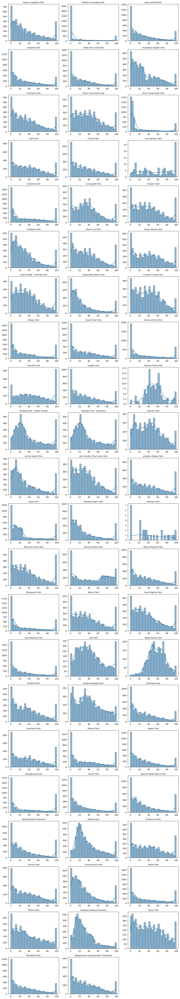

In [37]:
parks = final_merged_df['park_name'].unique()
n = len(parks)
cols = 3
rows = int(np.ceil(n / cols))

fig, axes = plt.subplots(rows, cols, figsize=(12, rows * 3))
axes = axes.flatten()

for i, park in enumerate(parks):
    df_park = final_merged_df[final_merged_df['park_name'] == park]
    sns.histplot(df_park['popularTimesLivePercent'], kde=True, bins=30, ax=axes[i])
    axes[i].set_title(park, fontsize=9)
    axes[i].set_xlabel("")
    axes[i].set_ylabel("")

# Hide any extra axes
for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.show()

# Feature Engineering

Categorized rain and snow based on preciptype and icon

In [38]:
final_merged_df['preciptype'].value_counts()

preciptype
rain         76770
rain,snow     1674
snow           620
Name: count, dtype: int64

In [39]:
final_merged_df['icon'].isna().sum()

np.int64(31110)

In [40]:
final_merged_df['preciptype'].isna().sum()

np.int64(297161)

In [41]:
# Ensure NaNs are treated as 'none'
final_merged_df['preciptype'] = final_merged_df['preciptype'].fillna('none')

# Binary flags
final_merged_df['precip_rain'] = (
    final_merged_df['preciptype'].str.contains('rain', na=False) |
    final_merged_df['icon'].str.contains('rain', na=False)
).astype(int)
final_merged_df['precip_snow'] = final_merged_df['preciptype'].str.contains('snow').astype(int)

In [42]:
final_merged_df.head()

,DateTimeCollected_PST,categoryName,park_name,Classification,popularTimesLivePercent,hour,dayofweek,date_rounded,temp,precip,preciptype,precipprob,snow,datetime,date,time_24,icon,precip_rain,precip_snow
0,2024-05-24 18:16:17.900000-07:00,Park,Andy Livingstone Park,Community,30.0,18,4,2024-05-24 18:00:00,11.3,1.150,rain,100,0,2024-05-24 18:00:00,2024-05-24,18:00,rain,1,0
1,2024-05-24 19:18:46.673000-07:00,Park,Andy Livingstone Park,Community,39.0,19,4,2024-05-24 19:00:00,11.1,0.007,rain,100,0,2024-05-24 19:00:00,2024-05-24,19:00,rain,1,0
2,2024-05-24 20:16:45.877000-07:00,Park,Andy Livingstone Park,Community,17.0,20,4,2024-05-24 20:00:00,11.0,0.000,none,0,0,2024-05-24 20:00:00,2024-05-24,20:00,cloudy,0,0
3,2024-05-24 21:15:26.013000-07:00,Park,Andy Livingstone Park,Community,13.0,21,4,2024-05-24 21:00:00,10.6,0.868,rain,100,0,2024-05-24 21:00:00,2024-05-24,21:00,rain,1,0
4,2024-05-24 22:17:01.224000-07:00,Park,Andy Livingstone Park,Community,8.0,22,4,2024-05-24 22:00:00,10.5,0.472,rain,100,0,2024-05-24 22:00:00,2024-05-24,22:00,rain,1,0


Add is_holiday feature based on BC statutory holidays from 2024-2025

In [43]:
# Define BC statutory holidays
bc_holidays = pd.to_datetime([
    "2024-01-01", "2024-02-19", "2024-03-29", "2024-05-20", "2024-07-01", "2024-08-05",
    "2024-09-02", "2024-09-30", "2024-10-14", "2024-11-11", "2024-12-25",
    "2025-01-01", "2025-02-17", "2025-04-18", "2025-05-19", "2025-07-01", "2025-08-04",
    "2025-09-01", "2025-09-30", "2025-10-13", "2025-11-11", "2025-12-25"
])

# Ensure column is datetime
final_merged_df['date'] = pd.to_datetime(final_merged_df['date'], errors='coerce')

# Encode holiday as binary flag
final_merged_df['is_holiday'] = final_merged_df['date'].isin(bc_holidays).astype(int)

Add is_weekend feature 

In [44]:
# Ensure date_pst is datetime
final_merged_df['date'] = pd.to_datetime(final_merged_df['date'], errors='coerce')

# Extract weekday (Monday=0, Sunday=6)
final_merged_df['is_weekend'] = final_merged_df['date'].dt.weekday.isin([5, 6]).astype(int)

Add has_event feature 

In [45]:
events_df = pd.read_csv("/Users/meylianisanjaya/Desktop/event_list.csv")

In [46]:
events_df.head()

,park_name,start_time,end_time,Event Name
0,Stanley Park,2024-05-04 8:00,2024-05-04 12:00,BMO Vancouver International Marathon
1,Stanley Park,2024-05-05 8:00,2024-05-05 12:00,BMO Vancouver International Marathon
2,Creekside Park,2024-05-11 8:00,2024-05-11 18:00,Knockout Dragon Boat Regatta
3,Creekside Park,2024-06-01 11:00,2024-06-01 17:00,Dragon Boat Vessi 500M Regatta
4,Oak Park,2024-06-01 11:00,2024-06-01 15:00,Marpole Oakridge Community Day


In [47]:
events_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 340 entries, 0 to 339
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   park_name   340 non-null    object
 1   start_time  340 non-null    object
 2   end_time    340 non-null    object
 3   Event Name  340 non-null    object
dtypes: object(4)
memory usage: 10.8+ KB


In [48]:
# Step 1: Convert start_time and end_time to datetime
events_df['start_time'] = pd.to_datetime(events_df['start_time'])
events_df['end_time'] = pd.to_datetime(events_df['end_time'])

# Step 2: Ensure final_merged_df['date_rounded'] is also datetime and timezone-naive
final_merged_df['date_rounded'] = pd.to_datetime(final_merged_df['date_rounded']).dt.tz_localize(None)

# Step 3: Initialize has_event column
final_merged_df['has_event'] = 0

# Step 4: Loop through each event and flag matching rows
for _, row in events_df.iterrows():
    match = (
        (final_merged_df['park_name'] == row['park_name']) &
        (final_merged_df['date_rounded'] >= row['start_time']) &
        (final_merged_df['date_rounded'] <= row['end_time'])
    )
    final_merged_df.loc[match, 'has_event'] = 1

In [49]:
final_merged_df[final_merged_df['has_event'] == 1].sort_values(['park_name', 'date_rounded'])

,DateTimeCollected_PST,categoryName,park_name,Classification,popularTimesLivePercent,hour,dayofweek,date_rounded,temp,precip,...,snow,datetime,date,time_24,icon,precip_rain,precip_snow,is_holiday,is_weekend,has_event
85788,2024-05-11 08:12:53.918000-07:00,Park,Creekside Park,Neighbourhood,41.0,8,5,2024-05-11 08:00:00,15.0,0.0,...,0,2024-05-11 08:00:00,2024-05-11,08:00,clear-day,0,0,0,1,1
85789,2024-05-11 09:13:32.051000-07:00,Park,Creekside Park,Neighbourhood,100.0,9,5,2024-05-11 09:00:00,15.6,0.0,...,0,2024-05-11 09:00:00,2024-05-11,09:00,partly-cloudy-day,0,0,0,1,1
85790,2024-05-11 10:12:45.856000-07:00,Park,Creekside Park,Neighbourhood,100.0,10,5,2024-05-11 10:00:00,17.1,0.0,...,0,2024-05-11 10:00:00,2024-05-11,10:00,partly-cloudy-day,0,0,0,1,1
85791,2024-05-11 11:13:47.577000-07:00,Park,Creekside Park,Neighbourhood,100.0,11,5,2024-05-11 11:00:00,17.2,0.0,...,0,2024-05-11 11:00:00,2024-05-11,11:00,partly-cloudy-day,0,0,0,1,1
85792,2024-05-11 12:12:33.589000-07:00,Park,Creekside Park,Neighbourhood,3.0,12,5,2024-05-11 12:00:00,17.6,0.0,...,0,2024-05-11 12:00:00,2024-05-11,12:00,partly-cloudy-day,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360251,2024-09-20 20:14:23.015000-07:00,Park,Vanier Park,Destination,97.0,20,4,2024-09-20 20:00:00,13.3,0.0,...,0,2024-09-20 20:00:00,2024-09-20,20:00,partly-cloudy-night,0,0,0,0,1
360261,2024-09-21 13:14:01.765000-07:00,Park,Vanier Park,Destination,43.0,13,5,2024-09-21 13:00:00,16.8,0.0,...,0,2024-09-21 13:00:00,2024-09-21,13:00,clear-day,0,0,0,1,1
360262,2024-09-21 14:16:32.950000-07:00,Park,Vanier Park,Destination,93.0,14,5,2024-09-21 14:00:00,17.3,0.0,...,0,2024-09-21 14:00:00,2024-09-21,14:00,partly-cloudy-day,0,0,0,1,1
360267,2024-09-21 19:15:19.488000-07:00,Park,Vanier Park,Destination,57.0,19,5,2024-09-21 19:00:00,14.9,0.0,...,0,2024-09-21 19:00:00,2024-09-21,19:00,partly-cloudy-day,0,0,0,1,1


In [50]:
final_merged_df.shape

(376225, 22)

In [51]:
final_merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 376225 entries, 0 to 376224
Data columns (total 22 columns):
 #   Column                   Non-Null Count   Dtype                            
---  ------                   --------------   -----                            
 0   DateTimeCollected_PST    376225 non-null  datetime64[ns, America/Vancouver]
 1   categoryName             376225 non-null  object                           
 2   park_name                376225 non-null  object                           
 3   Classification           376225 non-null  object                           
 4   popularTimesLivePercent  376225 non-null  float64                          
 5   hour                     376225 non-null  int32                            
 6   dayofweek                376225 non-null  int32                            
 7   date_rounded             376225 non-null  datetime64[ns]                   
 8   temp                     376225 non-null  float64                         

Clean dataframe and delete unneccesary columns

In [52]:
selected_cols = ['date_rounded', 'park_name', 'popularTimesLivePercent', 'temp', 'precip_rain', 'precip_snow','is_holiday','is_weekend','has_event']
final_merged_cleaned = final_merged_df[selected_cols]

In [53]:
final_merged_cleaned.head()

,date_rounded,park_name,popularTimesLivePercent,temp,precip_rain,precip_snow,is_holiday,is_weekend,has_event
0,2024-05-24 18:00:00,Andy Livingstone Park,30.0,11.3,1,0,0,0,0
1,2024-05-24 19:00:00,Andy Livingstone Park,39.0,11.1,1,0,0,0,0
2,2024-05-24 20:00:00,Andy Livingstone Park,17.0,11.0,0,0,0,0,0
3,2024-05-24 21:00:00,Andy Livingstone Park,13.0,10.6,1,0,0,0,0
4,2024-05-24 22:00:00,Andy Livingstone Park,8.0,10.5,1,0,0,0,0


# Time Series Forecasting Model

Initial Visualization

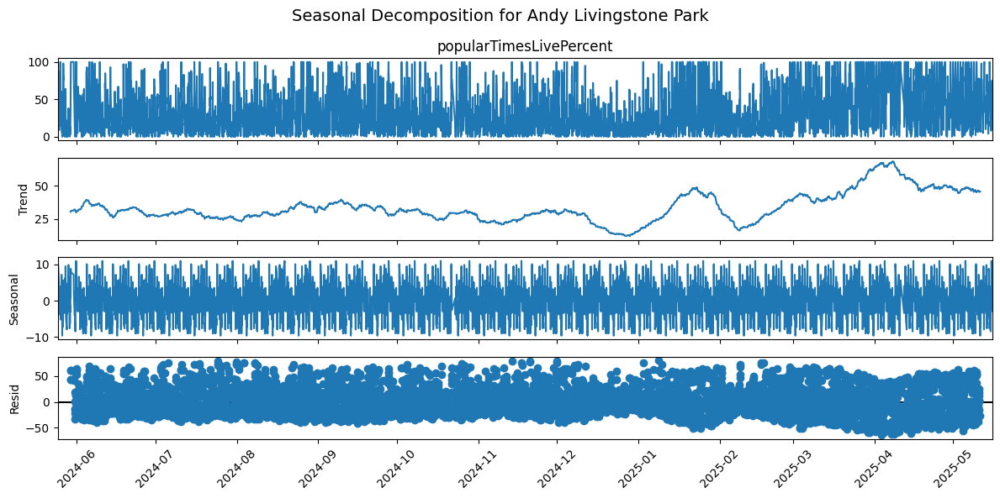

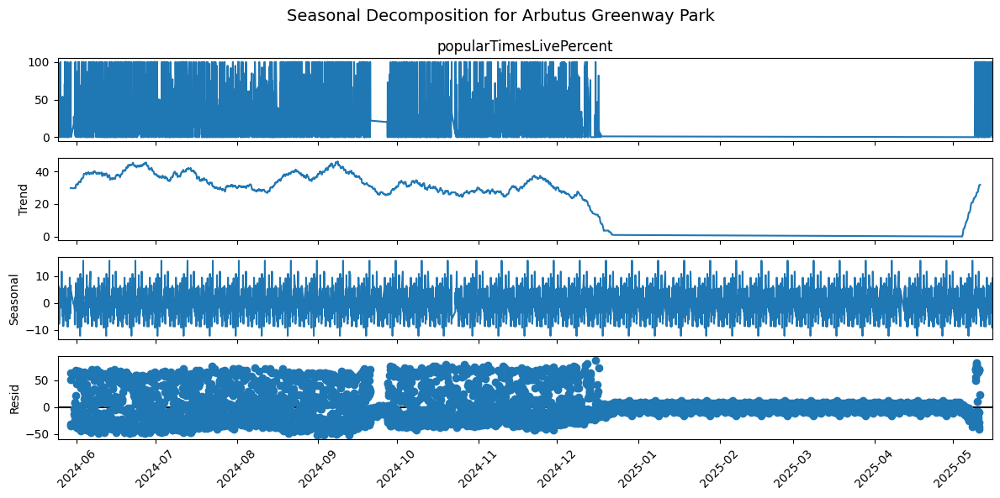

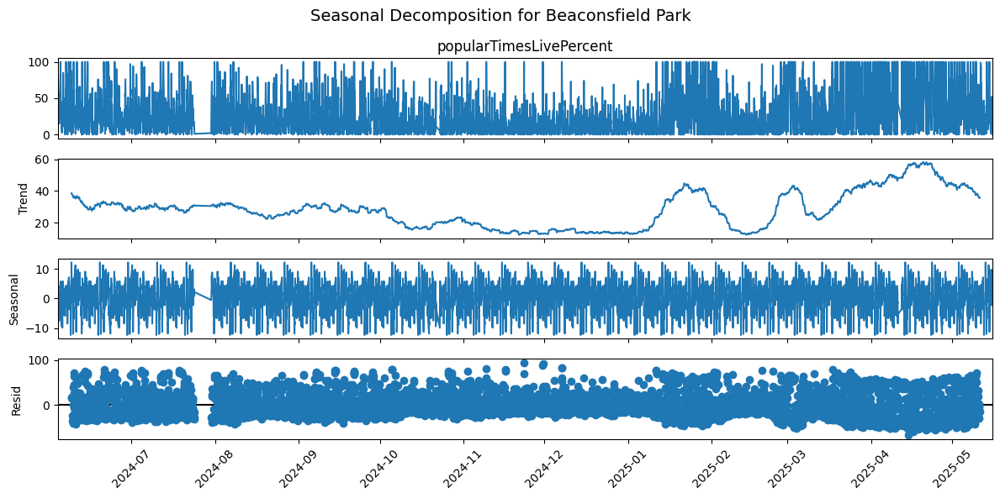

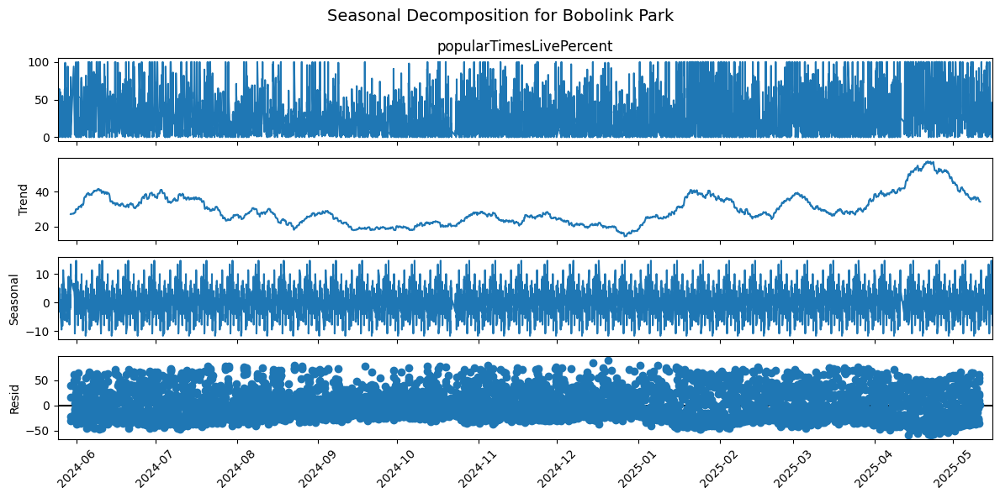

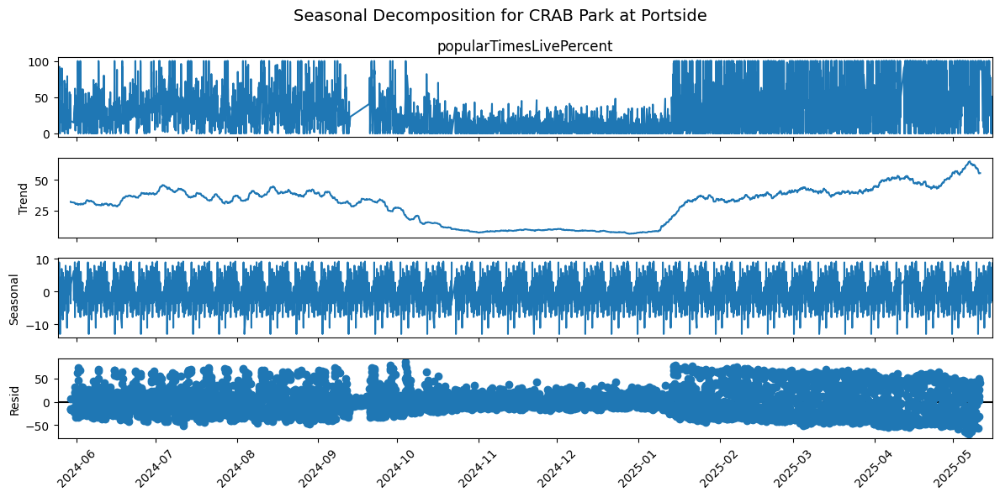

...

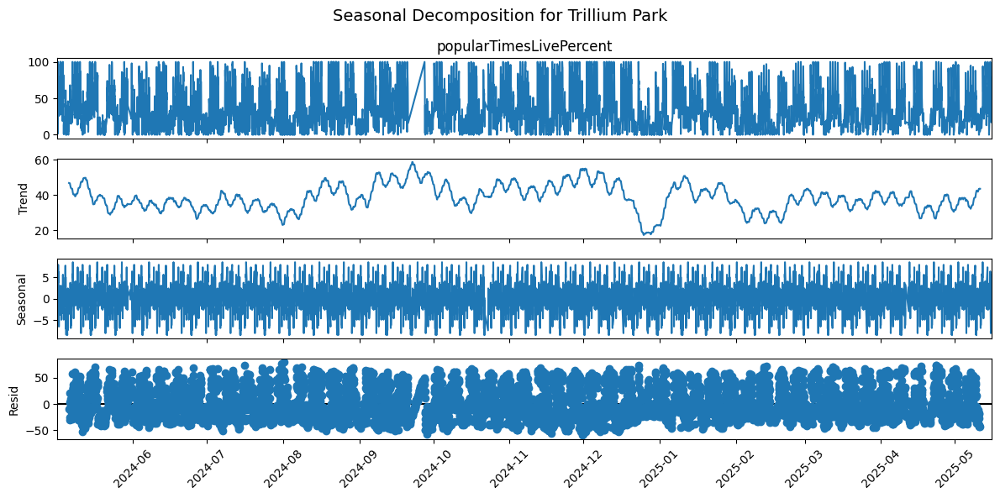

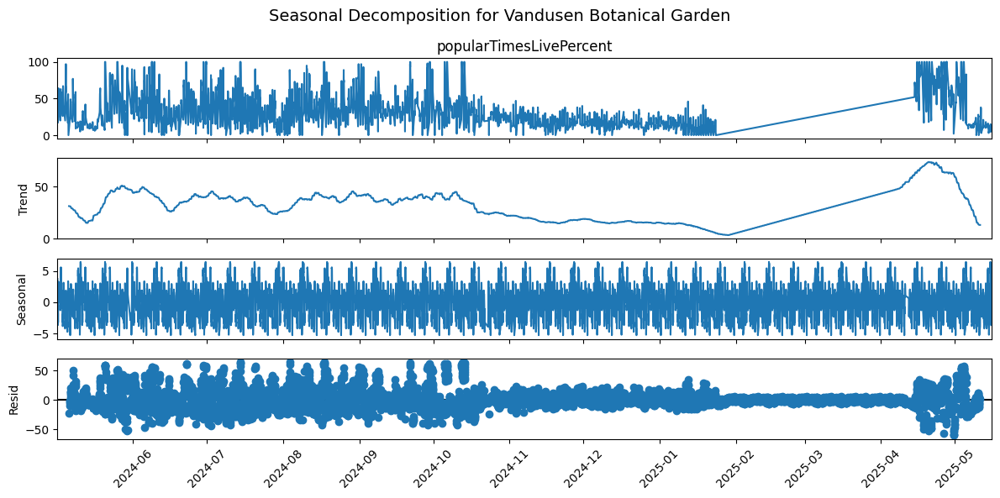

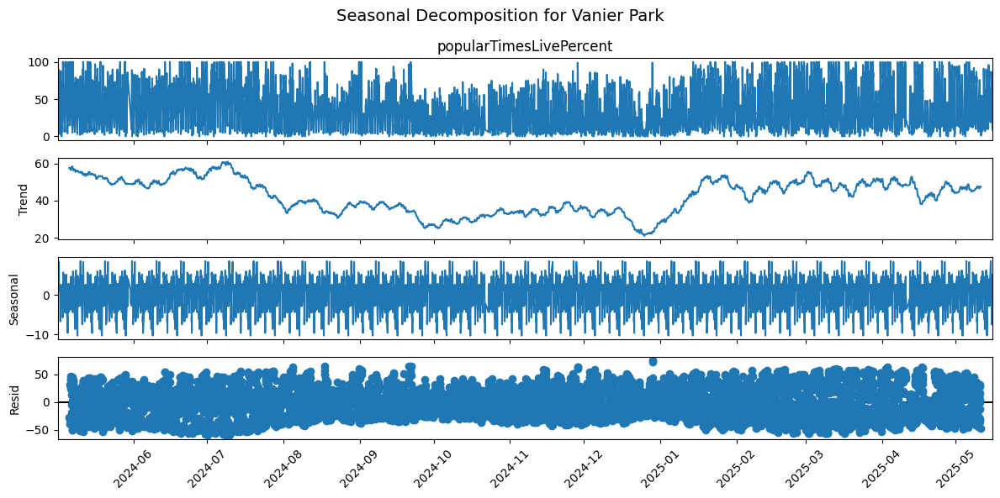

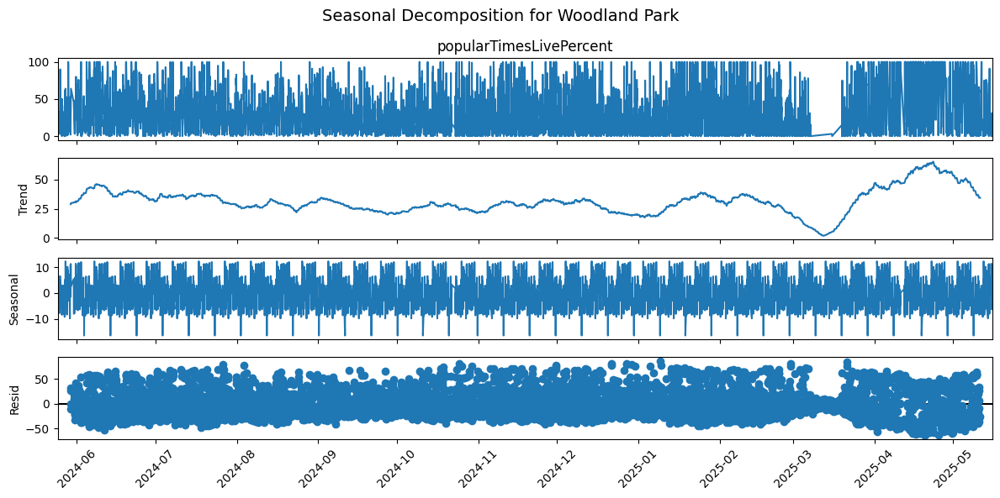

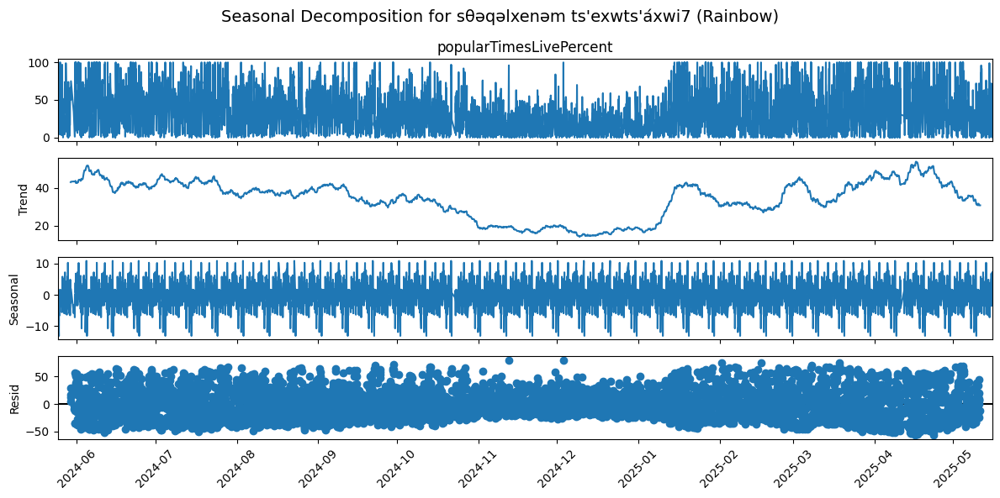

In [54]:
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

for park in final_merged_cleaned['park_name'].unique():
    df_park = final_merged_cleaned[final_merged_cleaned['park_name'] == park].copy()
    df_park = df_park.sort_values('date_rounded')
    df_park.set_index('date_rounded', inplace=True)

    if df_park['popularTimesLivePercent'].notna().sum() < 168:
        continue

    try:
        result = seasonal_decompose(
            df_park['popularTimesLivePercent'],
            model='additive',
            period=24 * 7
        )

        # Plot and format
        fig = result.plot()
        fig.set_size_inches(12, 6)

        for ax in fig.axes:
            ax.xaxis.set_major_locator(mdates.MonthLocator(interval=1))
            ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
            ax.tick_params(axis='x', rotation=45)

        plt.suptitle(f"Seasonal Decomposition for {park}", fontsize=14)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f" Skipping {park} due to error: {e}")

Check Stationarity using ADF

In [55]:
from statsmodels.tsa.stattools import adfuller

# Ensure time column is datetime and data is sorted
df = final_merged_cleaned.sort_values(by='date_rounded').copy()  # or 'datetime_pst'

# Prepare to collect ADF test results
adf_results = []

# Loop through each unique park
for park in df['park_name'].unique():
    # Subset and sort data
    park_df = df[df['park_name'] == park].sort_values(by='date_rounded')
    series = park_df['popularTimesLivePercent'].dropna()

    # Skip if insufficient data
    if len(series) < 20:
        continue

    # Run ADF test
    result = adfuller(series)

    # Store results
    adf_results.append({
        'park_name': park,
        'adf_statistic': result[0],
        'p_value': result[1],
        'stationary': result[1] < 0.05,
        'n_obs': len(series)
    })

# Convert to DataFrame
adf_df = pd.DataFrame(adf_results)

# Optional: display or export
display(adf_df)

# Export to CSV if needed
# adf_df.to_csv("adf_results_by_park.csv", index=False)


,park_name,adf_statistic,p_value,stationary,n_obs
0,Musqueam Park,-4.637511,1.100955e-04,True,6393
1,Champlain Heights Park,-3.021590,3.292681e-02,True,6393
2,Quilchena Park,-6.444208,1.580617e-08,True,6393
3,Strathcona Park,-8.062434,1.629399e-12,True,6274
4,Charleson Park,-7.416732,6.903974e-11,True,6390
...,...,...,...,...,...
60,Beaconsfield Park,-6.883838,1.411046e-09,True,5675
61,Oppenheimer Park,-6.831731,1.886168e-09,True,2526
62,Harbour Green Park,-3.954132,1.670678e-03,True,141
63,Coal Harbour Park,-6.647519,5.220169e-09,True,141


In [119]:
adf_df['stationary'].value_counts()

stationary
True     64
False     1
Name: count, dtype: int64

Check Unique Hours per park

In [56]:
hour_map = {
    park: sorted(group['date_rounded'].dt.hour.unique().tolist())
    for park, group in final_merged_cleaned.groupby('park_name')
}

hour_df = pd.DataFrame([
    {'park_name': park, 'unique_hours': sorted(group['date_rounded'].dt.hour.unique().tolist())}
    for park, group in final_merged_cleaned.groupby('park_name')
])

pd.set_option('display.max_colwidth', None) 
display(hour_df) 

,park_name,unique_hours
0,Andy Livingstone Park,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
1,Arbutus Greenway Park,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
2,Beaconsfield Park,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
3,Bobolink Park,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
4,CRAB Park at Portside,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
...,...,...
60,Trillium Park,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
61,Vandusen Botanical Garden,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
62,Vanier Park,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"
63,Woodland Park,"[6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22]"


In [57]:
final_merged_cleaned.head()

,date_rounded,park_name,popularTimesLivePercent,temp,precip_rain,precip_snow,is_holiday,is_weekend,has_event
0,2024-05-24 18:00:00,Andy Livingstone Park,30.0,11.3,1,0,0,0,0
1,2024-05-24 19:00:00,Andy Livingstone Park,39.0,11.1,1,0,0,0,0
2,2024-05-24 20:00:00,Andy Livingstone Park,17.0,11.0,0,0,0,0,0
3,2024-05-24 21:00:00,Andy Livingstone Park,13.0,10.6,1,0,0,0,0
4,2024-05-24 22:00:00,Andy Livingstone Park,8.0,10.5,1,0,0,0,0


In [ ]:
# Export to .csv
#final_merged_cleaned.to_csv('final_merged_cleaned.csv', index=False)

# LightGBM Pipeline

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import lightgbm as lgb
import optuna # for optimization

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder

class SimpleMultiParkLightGBM:
    def __init__(self, df, target_col='popularTimesLivePercent', park_col='park_name'):
        self.df = df.copy()
        self.target_col = target_col
        self.park_col = park_col
        self.models = {}
        self.results = {}

        self.exog_features = ['temp', 'precip_rain', 'is_weekend', 'has_event', 'precip_snow', 'is_holiday']
        self.time_features = []
        self.lag_features = []
        print("✅ Pipeline initialized.")

    def create_features(self):
        df = self.df

        if not isinstance(df.index, pd.DatetimeIndex):
            raise ValueError("Index must be a DatetimeIndex.")

        df['hour'] = df.index.hour
        df['hour_op'] = (df['hour'] - 6) % 17
        df['day_of_week'] = df.index.dayofweek
        df['month'] = df.index.month

        df['hour_sin'] = np.sin(2 * np.pi * df['hour_op'] / 17)
        df['hour_cos'] = np.cos(2 * np.pi * df['hour_op'] / 17)

        self.time_features = ['hour_op', 'day_of_week', 'month', 'hour_sin', 'hour_cos']

        for lag in [1, 2, 3, 17]:
            df[f'lag_{lag}'] = df.groupby(self.park_col)[self.target_col].shift(lag)
            self.lag_features.append(f'lag_{lag}')

        df['park_encoded'] = LabelEncoder().fit_transform(df[self.park_col])
        self.df = df.dropna()

    def optimize_model(self, X_train, y_train, X_val, y_val, n_trials=20):
        def objective(trial):
            params = {
                'objective': 'regression',
                'metric': 'rmse',
                'verbosity': -1,
                'boosting_type': 'gbdt',
                'learning_rate': trial.suggest_float("learning_rate", 0.01, 0.3),
                'num_leaves': trial.suggest_int("num_leaves", 20, 150),
                'feature_fraction': trial.suggest_float("feature_fraction", 0.5, 1.0),
                'bagging_fraction': trial.suggest_float("bagging_fraction", 0.5, 1.0),
                'bagging_freq': trial.suggest_int("bagging_freq", 1, 10),
                'min_child_samples': trial.suggest_int("min_child_samples", 5, 100)
            }

            model = lgb.LGBMRegressor(**params)
            model.fit(X_train, y_train)
            preds = model.predict(X_val)
    
            rmse = np.sqrt(mean_squared_error(y_val, preds))
            return rmse

        study = optuna.create_study(direction="minimize")
        study.optimize(objective, n_trials=n_trials, show_progress_bar=False)
        return study.best_params

    def train_models(self, test_size=0.2, optimize=False):
        parks = self.df[self.park_col].unique()
        all_features = self.exog_features + self.time_features + self.lag_features + ['park_encoded']

        for park in parks:
            park_data = self.df[self.df[self.park_col] == park]
            split = int(len(park_data) * (1 - test_size))
            train = park_data.iloc[:split]
            test = park_data.iloc[split:]

            X_train, y_train = train[all_features], train[self.target_col]
            X_test, y_test = test[all_features], test[self.target_col]

            if optimize:
                print(f" Optimizing model for {park}...")
                val_size = int(len(X_train) * 0.2)
                X_val = X_train.iloc[-val_size:]
                y_val = y_train.iloc[-val_size:]
                X_train_ = X_train.iloc[:-val_size]
                y_train_ = y_train.iloc[:-val_size]
                best_params = self.optimize_model(X_train_, y_train_, X_val, y_val)
                model = lgb.LGBMRegressor(**best_params)
            else:
                model = lgb.LGBMRegressor()

            model.fit(X_train, y_train)
            preds = model.predict(X_test)

            self.models[park] = model
            self.results[park] = {
                'test_dates': test.index,
                'actual': y_test,
                'predicted': preds,
                'metrics': {
                    'MAE': mean_absolute_error(y_test, preds),
                    'RMSE': np.sqrt(mean_squared_error(y_test, preds)),
                    'R2': r2_score(y_test, preds)
                }
            }
            print(f"✅ Trained model for {park} - R²: {self.results[park]['metrics']['R2']:.3f}")

    def plot_results(self, parks=None, smooth=True, window=6):
        if parks is None:
            parks = list(self.models.keys())

        for park in parks:
            result = self.results[park]
            actual = result['actual']
            pred = pd.Series(result['predicted'], index=result['test_dates'])

            if smooth:
                actual = actual.rolling(window=window, center=True).mean()
                pred = pred.rolling(window=window, center=True).mean()

            plt.figure(figsize=(12, 4))
            plt.plot(actual, label='Actual (Smoothed)' if smooth else 'Actual', color='darkorange')
            plt.plot(pred, label='Predicted (Smoothed)' if smooth else 'Predicted', color='steelblue')
            plt.title(f"{park} Forecast - R²: {result['metrics']['R2']:.3f}")
            plt.ylabel(self.target_col)
            plt.xlabel("Date")
            plt.legend()
            plt.grid(True, alpha=0.3)
            plt.tight_layout()
            plt.show()

    def run_pipeline(self, optimize=False, n_trials=20):
        print("🚀 Running Simple Multi-Park LightGBM Pipeline...")
        self.create_features()
        self.train_models(optimize=optimize, test_size=0.2)
        self.plot_results()


# Baseline Model

✅ Pipeline initialized.
🚀 Running Simple Multi-Park LightGBM Pipeline...
✅ Trained model for Andy Livingstone Park - R²: 0.498
✅ Trained model for Arbutus Greenway Park - R²: 0.116
✅ Trained model for Beaconsfield Park - R²: 0.306
✅ Trained model for Bobolink Park - R²: 0.186
✅ Trained model for CRAB Park at Portside - R²: -0.002
✅ Trained model for Champlain Heights Park - R²: 0.692
✅ Trained model for Charleson Park - R²: 0.480
✅ Trained model for China Creek North Park - R²: 0.330
✅ Trained model for China Creek South Park - R²: 0.184
✅ Trained model for Clark Park - R²: 0.286
✅ Trained model for Clinton Park - R²: 0.392
✅ Trained model for Coal Harbour Park - R²: 0.082
✅ Trained model for Columbia Park - R²: 0.161
✅ Trained model for Connaught Park - R²: 0.711
✅ Trained model for Coopers' Park - R²: 0.607
✅ Trained model for Creekside Park - R²: 0.697
✅ Trained model for David Lam Park - R²: 0.759
✅ Trained model for Emery Barnes Park - R²: 0.492
✅ Trained model for Empire Fields -

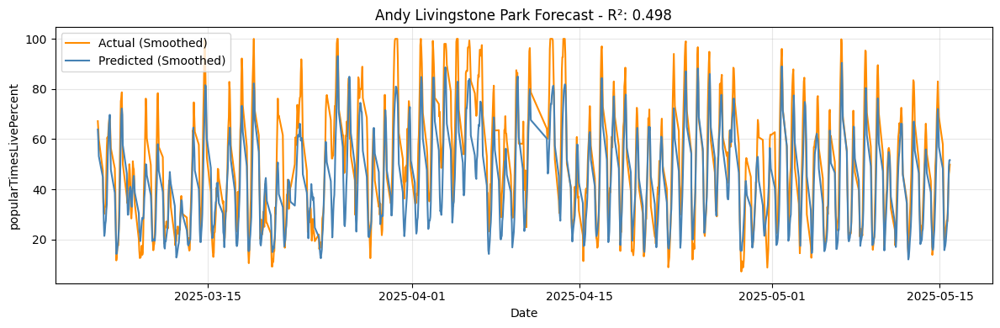

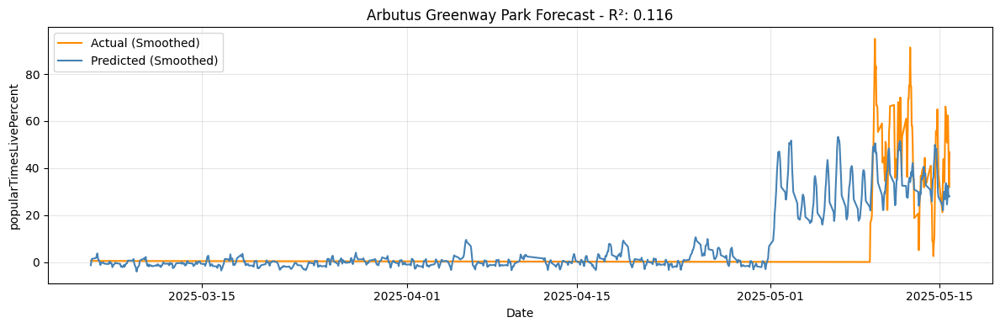

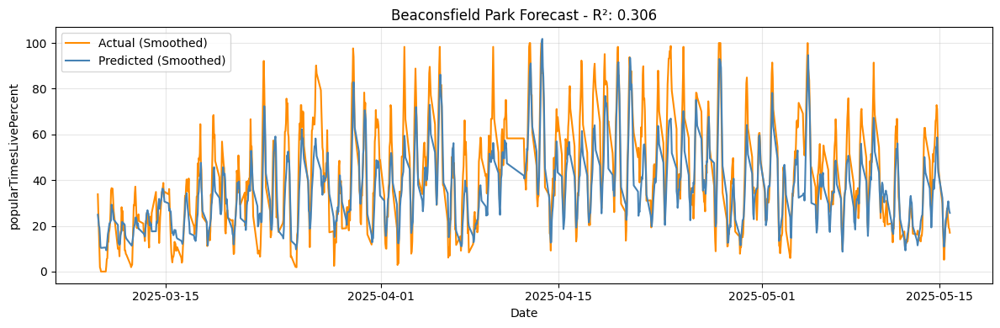

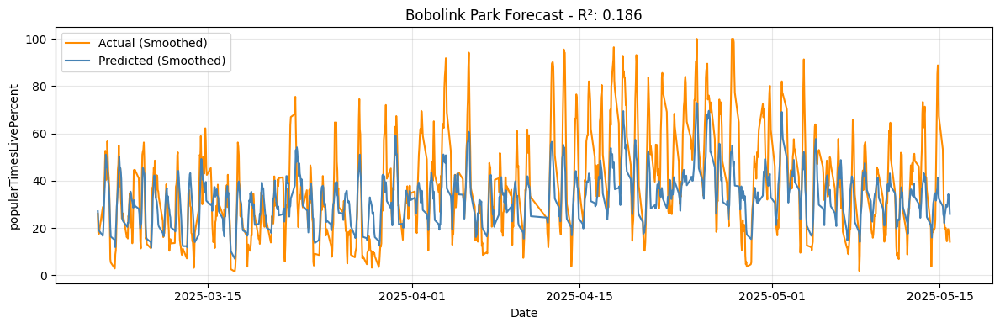

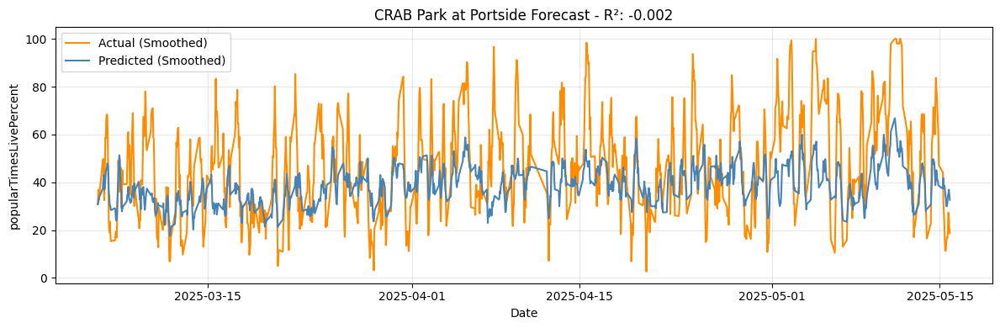

...

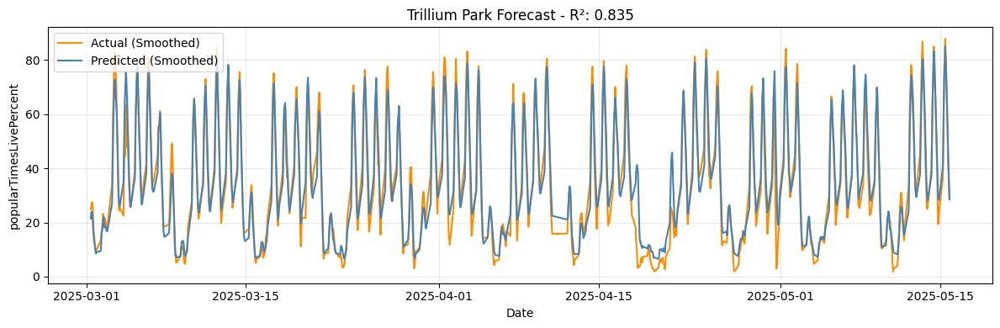

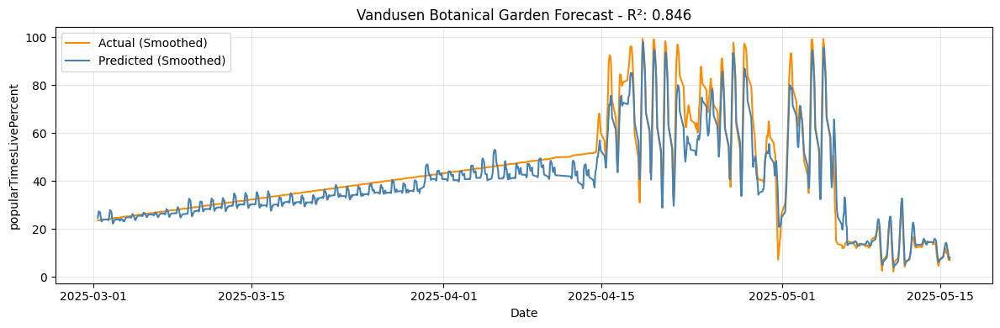

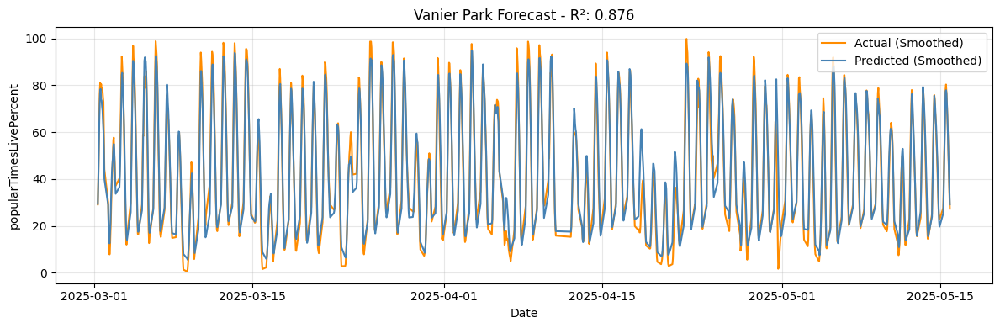

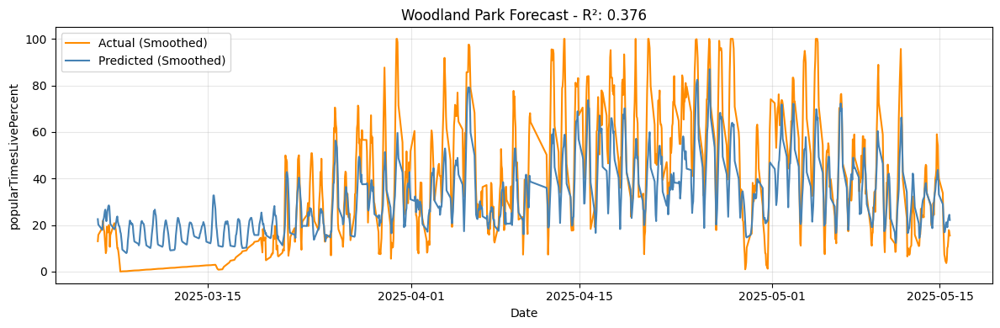

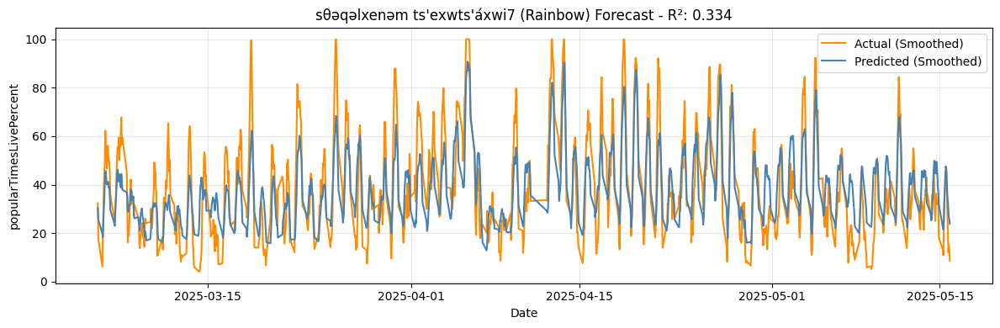

In [ ]:
baseline_model = SimpleMultiParkLightGBM(final_merged_cleaned)
baseline_model.run_pipeline(optimize=False)

# Optimization

[I 2025-06-19 16:36:13,176] A new study created in memory with name: no-name-7744a956-4e34-4843-a308-9fad355d47a3


✅ Pipeline initialized.
🚀 Running Simple Multi-Park LightGBM Pipeline...
🔍 Optimizing model for Andy Livingstone Park...


[I 2025-06-19 16:36:13,832] Trial 0 finished with value: 24.527487892216097 and parameters: {'learning_rate': 0.07534422157510284, 'num_leaves': 56, 'feature_fraction': 0.8820523283286974, 'bagging_fraction': 0.8233959174252055, 'bagging_freq': 3, 'min_child_samples': 27}. Best is trial 0 with value: 24.527487892216097.
[I 2025-06-19 16:36:14,327] Trial 1 finished with value: 25.400965732246192 and parameters: {'learning_rate': 0.19448466935566566, 'num_leaves': 39, 'feature_fraction': 0.5965162657022461, 'bagging_fraction': 0.5000046949940135, 'bagging_freq': 4, 'min_child_samples': 30}. Best is trial 0 with value: 24.527487892216097.
[I 2025-06-19 16:36:14,804] Trial 2 finished with value: 25.229423360235593 and parameters: {'learning_rate': 0.24679382354595408, 'num_leaves': 78, 'feature_fraction': 0.7011428204616805, 'bagging_fraction': 0.9689095373515164, 'bagging_freq': 4, 'min_child_samples': 66}. Best is trial 0 with value: 24.527487892216097.
[I 2025-06-19 16:36:15,393] Trial 

✅ Trained model for Andy Livingstone Park - R²: 0.484
🔍 Optimizing model for Arbutus Greenway Park...


[I 2025-06-19 16:36:23,163] Trial 0 finished with value: 14.753795461112057 and parameters: {'learning_rate': 0.29713367953358016, 'num_leaves': 39, 'feature_fraction': 0.5786923767209953, 'bagging_fraction': 0.6237368285672271, 'bagging_freq': 6, 'min_child_samples': 35}. Best is trial 0 with value: 14.753795461112057.
[I 2025-06-19 16:36:23,537] Trial 1 finished with value: 7.282006606232912 and parameters: {'learning_rate': 0.21388819314734236, 'num_leaves': 139, 'feature_fraction': 0.6285081547960817, 'bagging_fraction': 0.9813699491679797, 'bagging_freq': 2, 'min_child_samples': 96}. Best is trial 1 with value: 7.282006606232912.
[I 2025-06-19 16:36:25,098] Trial 2 finished with value: 20.551343167945866 and parameters: {'learning_rate': 0.2639062053056932, 'num_leaves': 143, 'feature_fraction': 0.9621928402852573, 'bagging_fraction': 0.674155861000796, 'bagging_freq': 1, 'min_child_samples': 10}. Best is trial 1 with value: 7.282006606232912.
[I 2025-06-19 16:36:25,442] Trial 3 f

✅ Trained model for Arbutus Greenway Park - R²: 0.318
🔍 Optimizing model for Beaconsfield Park...


[I 2025-06-19 16:36:33,427] Trial 0 finished with value: 26.969394128214123 and parameters: {'learning_rate': 0.028903629349578706, 'num_leaves': 36, 'feature_fraction': 0.8778818937911923, 'bagging_fraction': 0.5664813506845098, 'bagging_freq': 8, 'min_child_samples': 60}. Best is trial 0 with value: 26.969394128214123.
[I 2025-06-19 16:36:34,151] Trial 1 finished with value: 27.554800639299632 and parameters: {'learning_rate': 0.09012052338429427, 'num_leaves': 76, 'feature_fraction': 0.6280089348951052, 'bagging_fraction': 0.6218010143551195, 'bagging_freq': 3, 'min_child_samples': 29}. Best is trial 0 with value: 26.969394128214123.
[I 2025-06-19 16:36:34,473] Trial 2 finished with value: 27.326475420817125 and parameters: {'learning_rate': 0.12580601018752868, 'num_leaves': 37, 'feature_fraction': 0.8112388383634521, 'bagging_fraction': 0.9585322220879531, 'bagging_freq': 6, 'min_child_samples': 93}. Best is trial 0 with value: 26.969394128214123.
[I 2025-06-19 16:36:35,205] Trial

✅ Trained model for Beaconsfield Park - R²: 0.292
🔍 Optimizing model for Bobolink Park...


[I 2025-06-19 16:36:46,040] Trial 0 finished with value: 31.357172305186328 and parameters: {'learning_rate': 0.13901997026081964, 'num_leaves': 144, 'feature_fraction': 0.6048918642939418, 'bagging_fraction': 0.9440874777182671, 'bagging_freq': 4, 'min_child_samples': 58}. Best is trial 0 with value: 31.357172305186328.
[I 2025-06-19 16:36:46,576] Trial 1 finished with value: 32.727072394184844 and parameters: {'learning_rate': 0.2462499575921122, 'num_leaves': 89, 'feature_fraction': 0.6834135276973181, 'bagging_fraction': 0.6672780964975233, 'bagging_freq': 10, 'min_child_samples': 40}. Best is trial 0 with value: 31.357172305186328.
[I 2025-06-19 16:36:47,078] Trial 2 finished with value: 30.613095254625346 and parameters: {'learning_rate': 0.016061530162400802, 'num_leaves': 108, 'feature_fraction': 0.7970923145460238, 'bagging_fraction': 0.94855705870317, 'bagging_freq': 4, 'min_child_samples': 63}. Best is trial 2 with value: 30.613095254625346.
[I 2025-06-19 16:36:48,767] Trial

✅ Trained model for Bobolink Park - R²: 0.223
🔍 Optimizing model for CRAB Park at Portside...


[I 2025-06-19 16:36:56,822] Trial 0 finished with value: 41.11997258809913 and parameters: {'learning_rate': 0.1578512861637745, 'num_leaves': 117, 'feature_fraction': 0.8444992797460722, 'bagging_fraction': 0.7354781910508983, 'bagging_freq': 9, 'min_child_samples': 25}. Best is trial 0 with value: 41.11997258809913.
[I 2025-06-19 16:36:57,158] Trial 1 finished with value: 38.64519201987389 and parameters: {'learning_rate': 0.06872134877873172, 'num_leaves': 31, 'feature_fraction': 0.5984974883885706, 'bagging_fraction': 0.6035353507503658, 'bagging_freq': 9, 'min_child_samples': 76}. Best is trial 1 with value: 38.64519201987389.
[I 2025-06-19 16:36:57,657] Trial 2 finished with value: 39.85239020316094 and parameters: {'learning_rate': 0.06597009232321291, 'num_leaves': 40, 'feature_fraction': 0.9757509267374902, 'bagging_fraction': 0.7727361663798318, 'bagging_freq': 9, 'min_child_samples': 22}. Best is trial 1 with value: 38.64519201987389.
[I 2025-06-19 16:36:58,147] Trial 3 fini

✅ Trained model for CRAB Park at Portside - R²: -0.023
🔍 Optimizing model for Champlain Heights Park...


[I 2025-06-19 16:37:05,464] Trial 0 finished with value: 7.537179079529043 and parameters: {'learning_rate': 0.03408090603657254, 'num_leaves': 117, 'feature_fraction': 0.969654355390223, 'bagging_fraction': 0.6961669291291821, 'bagging_freq': 2, 'min_child_samples': 28}. Best is trial 0 with value: 7.537179079529043.
[I 2025-06-19 16:37:05,772] Trial 1 finished with value: 8.370362872658509 and parameters: {'learning_rate': 0.2793636107120686, 'num_leaves': 148, 'feature_fraction': 0.9139378051171783, 'bagging_fraction': 0.6243790702777529, 'bagging_freq': 5, 'min_child_samples': 76}. Best is trial 0 with value: 7.537179079529043.
[I 2025-06-19 16:37:06,324] Trial 2 finished with value: 9.42022994938348 and parameters: {'learning_rate': 0.24012414024027243, 'num_leaves': 88, 'feature_fraction': 0.8787174467545584, 'bagging_fraction': 0.7351151308860422, 'bagging_freq': 4, 'min_child_samples': 47}. Best is trial 0 with value: 7.537179079529043.
[I 2025-06-19 16:37:07,034] Trial 3 finis

✅ Trained model for Champlain Heights Park - R²: 0.698
🔍 Optimizing model for Charleson Park...


[I 2025-06-19 16:37:16,264] Trial 0 finished with value: 21.549857750292645 and parameters: {'learning_rate': 0.06821203982717892, 'num_leaves': 36, 'feature_fraction': 0.7035234117623106, 'bagging_fraction': 0.6440668903594388, 'bagging_freq': 7, 'min_child_samples': 48}. Best is trial 0 with value: 21.549857750292645.
[I 2025-06-19 16:37:17,389] Trial 1 finished with value: 22.623647418959514 and parameters: {'learning_rate': 0.20174906361693215, 'num_leaves': 117, 'feature_fraction': 0.5437485128463886, 'bagging_fraction': 0.8901237805169664, 'bagging_freq': 6, 'min_child_samples': 27}. Best is trial 0 with value: 21.549857750292645.
[I 2025-06-19 16:37:17,861] Trial 2 finished with value: 21.972099590731858 and parameters: {'learning_rate': 0.019099614900114324, 'num_leaves': 32, 'feature_fraction': 0.5323021512848507, 'bagging_fraction': 0.7342331364045869, 'bagging_freq': 10, 'min_child_samples': 6}. Best is trial 0 with value: 21.549857750292645.
[I 2025-06-19 16:37:18,655] Tria

✅ Trained model for Charleson Park - R²: 0.481
🔍 Optimizing model for China Creek North Park...


[I 2025-06-19 16:37:27,147] Trial 0 finished with value: 26.23131341689075 and parameters: {'learning_rate': 0.27838779246590395, 'num_leaves': 102, 'feature_fraction': 0.5145496963473377, 'bagging_fraction': 0.770050154535783, 'bagging_freq': 3, 'min_child_samples': 37}. Best is trial 0 with value: 26.23131341689075.
[I 2025-06-19 16:37:27,637] Trial 1 finished with value: 25.0969973170147 and parameters: {'learning_rate': 0.20054484421342011, 'num_leaves': 42, 'feature_fraction': 0.6545616784730213, 'bagging_fraction': 0.8647582264374981, 'bagging_freq': 5, 'min_child_samples': 48}. Best is trial 1 with value: 25.0969973170147.
[I 2025-06-19 16:37:28,053] Trial 2 finished with value: 24.950703750446078 and parameters: {'learning_rate': 0.09584724965845558, 'num_leaves': 30, 'feature_fraction': 0.5664123108635526, 'bagging_fraction': 0.6484908364025251, 'bagging_freq': 1, 'min_child_samples': 20}. Best is trial 2 with value: 24.950703750446078.
[I 2025-06-19 16:37:28,467] Trial 3 fini

✅ Trained model for China Creek North Park - R²: 0.340
🔍 Optimizing model for China Creek South Park...


[I 2025-06-19 16:37:37,048] Trial 0 finished with value: 17.617431240865706 and parameters: {'learning_rate': 0.019824796625433554, 'num_leaves': 53, 'feature_fraction': 0.6436775849656458, 'bagging_fraction': 0.7592713741250585, 'bagging_freq': 10, 'min_child_samples': 98}. Best is trial 0 with value: 17.617431240865706.
[I 2025-06-19 16:37:38,130] Trial 1 finished with value: 14.65757923270349 and parameters: {'learning_rate': 0.06661982426682204, 'num_leaves': 107, 'feature_fraction': 0.5989788621320156, 'bagging_fraction': 0.8236077769168028, 'bagging_freq': 10, 'min_child_samples': 25}. Best is trial 1 with value: 14.65757923270349.
[I 2025-06-19 16:37:38,537] Trial 2 finished with value: 12.43038127502815 and parameters: {'learning_rate': 0.11772945755043449, 'num_leaves': 47, 'feature_fraction': 0.5208208186782464, 'bagging_fraction': 0.7196860551734258, 'bagging_freq': 1, 'min_child_samples': 67}. Best is trial 2 with value: 12.43038127502815.
[I 2025-06-19 16:37:38,970] Trial 

✅ Trained model for China Creek South Park - R²: 0.306
🔍 Optimizing model for Clark Park...


[I 2025-06-19 16:37:49,019] Trial 0 finished with value: 28.604489656813488 and parameters: {'learning_rate': 0.191183923165504, 'num_leaves': 23, 'feature_fraction': 0.9792683169315433, 'bagging_fraction': 0.9027963998329585, 'bagging_freq': 6, 'min_child_samples': 36}. Best is trial 0 with value: 28.604489656813488.
[I 2025-06-19 16:37:49,411] Trial 1 finished with value: 27.37417305969387 and parameters: {'learning_rate': 0.0830002203536865, 'num_leaves': 102, 'feature_fraction': 0.7170560955917924, 'bagging_fraction': 0.6302644218060247, 'bagging_freq': 5, 'min_child_samples': 56}. Best is trial 1 with value: 27.37417305969387.
[I 2025-06-19 16:37:49,696] Trial 2 finished with value: 27.774369234123768 and parameters: {'learning_rate': 0.1871896707378931, 'num_leaves': 90, 'feature_fraction': 0.8771227318352428, 'bagging_fraction': 0.6994243039816515, 'bagging_freq': 2, 'min_child_samples': 89}. Best is trial 1 with value: 27.37417305969387.
[I 2025-06-19 16:37:50,464] Trial 3 fini

✅ Trained model for Clark Park - R²: 0.312
🔍 Optimizing model for Clinton Park...


[I 2025-06-19 16:37:58,352] Trial 0 finished with value: 25.340205175207775 and parameters: {'learning_rate': 0.10885851610438935, 'num_leaves': 86, 'feature_fraction': 0.6452524191329454, 'bagging_fraction': 0.8915641059134862, 'bagging_freq': 7, 'min_child_samples': 51}. Best is trial 0 with value: 25.340205175207775.
[I 2025-06-19 16:37:58,691] Trial 1 finished with value: 25.492755473184836 and parameters: {'learning_rate': 0.20800710481628515, 'num_leaves': 61, 'feature_fraction': 0.822971509763311, 'bagging_fraction': 0.9507219808118774, 'bagging_freq': 6, 'min_child_samples': 99}. Best is trial 0 with value: 25.340205175207775.
[I 2025-06-19 16:37:59,201] Trial 2 finished with value: 26.07318028652901 and parameters: {'learning_rate': 0.23372567843120695, 'num_leaves': 67, 'feature_fraction': 0.7744474679478441, 'bagging_fraction': 0.7943948076819938, 'bagging_freq': 9, 'min_child_samples': 51}. Best is trial 0 with value: 25.340205175207775.
[I 2025-06-19 16:37:59,580] Trial 3 

✅ Trained model for Clinton Park - R²: 0.414
🔍 Optimizing model for Coal Harbour Park...


[I 2025-06-19 16:38:12,783] Trial 7 finished with value: 31.442418145882606 and parameters: {'learning_rate': 0.21710148714840954, 'num_leaves': 91, 'feature_fraction': 0.5270027644027541, 'bagging_fraction': 0.7635609534179817, 'bagging_freq': 10, 'min_child_samples': 54}. Best is trial 0 with value: 31.442418145882606.
[I 2025-06-19 16:38:12,803] Trial 8 finished with value: 31.442418145882606 and parameters: {'learning_rate': 0.20643946144648298, 'num_leaves': 122, 'feature_fraction': 0.8129564149527593, 'bagging_fraction': 0.6555954191112536, 'bagging_freq': 7, 'min_child_samples': 32}. Best is trial 0 with value: 31.442418145882606.
[I 2025-06-19 16:38:12,824] Trial 9 finished with value: 31.442418145882606 and parameters: {'learning_rate': 0.2875191472196916, 'num_leaves': 37, 'feature_fraction': 0.7375459171350561, 'bagging_fraction': 0.5689880868193671, 'bagging_freq': 5, 'min_child_samples': 31}. Best is trial 0 with value: 31.442418145882606.
[I 2025-06-19 16:38:12,874] Trial

✅ Trained model for Coal Harbour Park - R²: -0.442
🔍 Optimizing model for Columbia Park...


[I 2025-06-19 16:38:13,481] Trial 0 finished with value: 23.68193229883995 and parameters: {'learning_rate': 0.1859876894707442, 'num_leaves': 60, 'feature_fraction': 0.7603118901343227, 'bagging_fraction': 0.8180934602153602, 'bagging_freq': 7, 'min_child_samples': 90}. Best is trial 0 with value: 23.68193229883995.
[I 2025-06-19 16:38:13,728] Trial 1 finished with value: 20.267452050540037 and parameters: {'learning_rate': 0.23737428562461668, 'num_leaves': 143, 'feature_fraction': 0.9928402890152415, 'bagging_fraction': 0.6960089244334193, 'bagging_freq': 8, 'min_child_samples': 98}. Best is trial 1 with value: 20.267452050540037.
[I 2025-06-19 16:38:14,007] Trial 2 finished with value: 21.873671973564928 and parameters: {'learning_rate': 0.2897817319722753, 'num_leaves': 78, 'feature_fraction': 0.5878998906309253, 'bagging_fraction': 0.6968651621441182, 'bagging_freq': 1, 'min_child_samples': 87}. Best is trial 1 with value: 20.267452050540037.
[I 2025-06-19 16:38:14,352] Trial 3 f

✅ Trained model for Columbia Park - R²: 0.235
🔍 Optimizing model for Connaught Park...


[I 2025-06-19 16:38:21,400] Trial 0 finished with value: 18.32329938673559 and parameters: {'learning_rate': 0.06473436021500434, 'num_leaves': 123, 'feature_fraction': 0.8269132583543144, 'bagging_fraction': 0.6996161119199862, 'bagging_freq': 7, 'min_child_samples': 72}. Best is trial 0 with value: 18.32329938673559.
[I 2025-06-19 16:38:21,714] Trial 1 finished with value: 19.100910124466637 and parameters: {'learning_rate': 0.01751412184746356, 'num_leaves': 60, 'feature_fraction': 0.9590492742927593, 'bagging_fraction': 0.5925618978020859, 'bagging_freq': 10, 'min_child_samples': 61}. Best is trial 0 with value: 18.32329938673559.
[I 2025-06-19 16:38:21,959] Trial 2 finished with value: 18.412771826306866 and parameters: {'learning_rate': 0.16166999139456265, 'num_leaves': 78, 'feature_fraction': 0.7432106909775973, 'bagging_fraction': 0.6793046659629651, 'bagging_freq': 4, 'min_child_samples': 95}. Best is trial 0 with value: 18.32329938673559.
[I 2025-06-19 16:38:22,268] Trial 3 

✅ Trained model for Connaught Park - R²: 0.699
🔍 Optimizing model for Coopers' Park...


[I 2025-06-19 16:38:28,990] Trial 0 finished with value: 22.3488664395946 and parameters: {'learning_rate': 0.17883212003280616, 'num_leaves': 37, 'feature_fraction': 0.9883016579644497, 'bagging_fraction': 0.6345290368877474, 'bagging_freq': 6, 'min_child_samples': 46}. Best is trial 0 with value: 22.3488664395946.
[I 2025-06-19 16:38:29,590] Trial 1 finished with value: 21.219050384002507 and parameters: {'learning_rate': 0.0298246050827624, 'num_leaves': 142, 'feature_fraction': 0.6667933966000216, 'bagging_fraction': 0.9274017653752946, 'bagging_freq': 1, 'min_child_samples': 47}. Best is trial 1 with value: 21.219050384002507.
[I 2025-06-19 16:38:30,382] Trial 2 finished with value: 22.04601001951533 and parameters: {'learning_rate': 0.1285014516800637, 'num_leaves': 72, 'feature_fraction': 0.6052229631224849, 'bagging_fraction': 0.5740314121448953, 'bagging_freq': 8, 'min_child_samples': 23}. Best is trial 1 with value: 21.219050384002507.
[I 2025-06-19 16:38:31,524] Trial 3 fini

✅ Trained model for Coopers' Park - R²: 0.625
🔍 Optimizing model for Creekside Park...


[I 2025-06-19 16:38:39,893] Trial 0 finished with value: 17.38297300025264 and parameters: {'learning_rate': 0.19302302662932463, 'num_leaves': 77, 'feature_fraction': 0.8075541618472044, 'bagging_fraction': 0.549266012043292, 'bagging_freq': 2, 'min_child_samples': 31}. Best is trial 0 with value: 17.38297300025264.
[I 2025-06-19 16:38:40,200] Trial 1 finished with value: 16.67328133924796 and parameters: {'learning_rate': 0.07713753014318264, 'num_leaves': 26, 'feature_fraction': 0.6873381868322668, 'bagging_fraction': 0.5274583067875102, 'bagging_freq': 6, 'min_child_samples': 50}. Best is trial 1 with value: 16.67328133924796.
[I 2025-06-19 16:38:40,504] Trial 2 finished with value: 17.081524809789165 and parameters: {'learning_rate': 0.23457129250204517, 'num_leaves': 97, 'feature_fraction': 0.7352473065146663, 'bagging_fraction': 0.6627435040338339, 'bagging_freq': 5, 'min_child_samples': 80}. Best is trial 1 with value: 16.67328133924796.
[I 2025-06-19 16:38:41,122] Trial 3 fini

✅ Trained model for Creekside Park - R²: 0.710
🔍 Optimizing model for David Lam Park...


[I 2025-06-19 16:38:50,114] Trial 0 finished with value: 20.8853600991993 and parameters: {'learning_rate': 0.2159769087395196, 'num_leaves': 101, 'feature_fraction': 0.679867730041184, 'bagging_fraction': 0.5787540564895007, 'bagging_freq': 6, 'min_child_samples': 42}. Best is trial 0 with value: 20.8853600991993.
[I 2025-06-19 16:38:50,310] Trial 1 finished with value: 20.637792612864978 and parameters: {'learning_rate': 0.29662437353757776, 'num_leaves': 128, 'feature_fraction': 0.600993540000434, 'bagging_fraction': 0.500481937887943, 'bagging_freq': 1, 'min_child_samples': 95}. Best is trial 1 with value: 20.637792612864978.
[I 2025-06-19 16:38:51,078] Trial 2 finished with value: 20.607994104663472 and parameters: {'learning_rate': 0.051901626934215774, 'num_leaves': 71, 'feature_fraction': 0.9616446799197256, 'bagging_fraction': 0.9925746469198086, 'bagging_freq': 8, 'min_child_samples': 33}. Best is trial 2 with value: 20.607994104663472.
[I 2025-06-19 16:38:51,504] Trial 3 fin

✅ Trained model for David Lam Park - R²: 0.753
🔍 Optimizing model for Emery Barnes Park...


[I 2025-06-19 16:39:00,142] Trial 0 finished with value: 24.471537979092155 and parameters: {'learning_rate': 0.22139134688030357, 'num_leaves': 102, 'feature_fraction': 0.501652821737784, 'bagging_fraction': 0.9809546806690416, 'bagging_freq': 5, 'min_child_samples': 72}. Best is trial 0 with value: 24.471537979092155.
[I 2025-06-19 16:39:00,970] Trial 1 finished with value: 26.61619487920367 and parameters: {'learning_rate': 0.23533584094942547, 'num_leaves': 75, 'feature_fraction': 0.8102078386018943, 'bagging_fraction': 0.7549172364549481, 'bagging_freq': 6, 'min_child_samples': 18}. Best is trial 0 with value: 24.471537979092155.
[I 2025-06-19 16:39:01,414] Trial 2 finished with value: 24.708078480322282 and parameters: {'learning_rate': 0.2796253509196351, 'num_leaves': 105, 'feature_fraction': 0.5555297474719403, 'bagging_fraction': 0.8647156325008589, 'bagging_freq': 2, 'min_child_samples': 72}. Best is trial 0 with value: 24.471537979092155.
[I 2025-06-19 16:39:01,769] Trial 3

✅ Trained model for Emery Barnes Park - R²: 0.479
🔍 Optimizing model for Empire Fields - Hastings Park...


[I 2025-06-19 16:39:13,089] Trial 0 finished with value: 18.817447362419696 and parameters: {'learning_rate': 0.11549131635767859, 'num_leaves': 139, 'feature_fraction': 0.8344493795573922, 'bagging_fraction': 0.9319702335933139, 'bagging_freq': 9, 'min_child_samples': 75}. Best is trial 0 with value: 18.817447362419696.
[I 2025-06-19 16:39:13,458] Trial 1 finished with value: 19.212559692250384 and parameters: {'learning_rate': 0.15434898454858859, 'num_leaves': 104, 'feature_fraction': 0.8646492951065208, 'bagging_fraction': 0.6041198243791635, 'bagging_freq': 7, 'min_child_samples': 54}. Best is trial 0 with value: 18.817447362419696.
[I 2025-06-19 16:39:13,710] Trial 2 finished with value: 19.24442844909182 and parameters: {'learning_rate': 0.1956186871221413, 'num_leaves': 88, 'feature_fraction': 0.7482493791604421, 'bagging_fraction': 0.6905078521587034, 'bagging_freq': 5, 'min_child_samples': 93}. Best is trial 0 with value: 18.817447362419696.
[I 2025-06-19 16:39:14,099] Trial 

✅ Trained model for Empire Fields - Hastings Park - R²: 0.411
🔍 Optimizing model for English Bay Beach Park...


[I 2025-06-19 16:39:22,020] Trial 0 finished with value: 11.017689738870674 and parameters: {'learning_rate': 0.24876166614023568, 'num_leaves': 66, 'feature_fraction': 0.8628181727114654, 'bagging_fraction': 0.5699064063837409, 'bagging_freq': 2, 'min_child_samples': 99}. Best is trial 0 with value: 11.017689738870674.
[I 2025-06-19 16:39:22,653] Trial 1 finished with value: 10.950387510471847 and parameters: {'learning_rate': 0.03738738002877621, 'num_leaves': 92, 'feature_fraction': 0.8655184495578148, 'bagging_fraction': 0.6510069962543481, 'bagging_freq': 7, 'min_child_samples': 32}. Best is trial 1 with value: 10.950387510471847.
[I 2025-06-19 16:39:23,077] Trial 2 finished with value: 10.60606274380255 and parameters: {'learning_rate': 0.08374153527371504, 'num_leaves': 65, 'feature_fraction': 0.6370199119521835, 'bagging_fraction': 0.8789259492457198, 'bagging_freq': 10, 'min_child_samples': 73}. Best is trial 2 with value: 10.60606274380255.
[I 2025-06-19 16:39:23,419] Trial 3

✅ Trained model for English Bay Beach Park - R²: 0.880
🔍 Optimizing model for Everett Crowley Park...


[I 2025-06-19 16:39:32,450] Trial 0 finished with value: 19.725925450235014 and parameters: {'learning_rate': 0.02286733212084575, 'num_leaves': 48, 'feature_fraction': 0.7344804212124763, 'bagging_fraction': 0.9959788378557177, 'bagging_freq': 1, 'min_child_samples': 59}. Best is trial 0 with value: 19.725925450235014.
[I 2025-06-19 16:39:33,023] Trial 1 finished with value: 19.664427946900428 and parameters: {'learning_rate': 0.028750281100955007, 'num_leaves': 135, 'feature_fraction': 0.9363034357592457, 'bagging_fraction': 0.9343574890250737, 'bagging_freq': 8, 'min_child_samples': 55}. Best is trial 1 with value: 19.664427946900428.
[I 2025-06-19 16:39:33,303] Trial 2 finished with value: 19.560445025341792 and parameters: {'learning_rate': 0.09679569240818459, 'num_leaves': 23, 'feature_fraction': 0.6502690282910031, 'bagging_fraction': 0.533811769601351, 'bagging_freq': 8, 'min_child_samples': 70}. Best is trial 2 with value: 19.560445025341792.
[I 2025-06-19 16:39:33,523] Trial

✅ Trained model for Everett Crowley Park - R²: 0.471
🔍 Optimizing model for Falaise Park...


[I 2025-06-19 16:39:42,847] Trial 0 finished with value: 31.3141258181077 and parameters: {'learning_rate': 0.13724285838172434, 'num_leaves': 144, 'feature_fraction': 0.7764878249436851, 'bagging_fraction': 0.9207876988954591, 'bagging_freq': 8, 'min_child_samples': 22}. Best is trial 0 with value: 31.3141258181077.
[I 2025-06-19 16:39:43,207] Trial 1 finished with value: 31.149417044788862 and parameters: {'learning_rate': 0.1473957405843665, 'num_leaves': 62, 'feature_fraction': 0.8864865899149643, 'bagging_fraction': 0.7735939463081962, 'bagging_freq': 6, 'min_child_samples': 77}. Best is trial 1 with value: 31.149417044788862.
[I 2025-06-19 16:39:43,749] Trial 2 finished with value: 30.608384682052748 and parameters: {'learning_rate': 0.19001567307778247, 'num_leaves': 121, 'feature_fraction': 0.8440039269824299, 'bagging_fraction': 0.9700485495693353, 'bagging_freq': 2, 'min_child_samples': 61}. Best is trial 2 with value: 30.608384682052748.
[I 2025-06-19 16:39:44,103] Trial 3 f

✅ Trained model for Falaise Park - R²: 0.081
🔍 Optimizing model for Fraser River Park...


[I 2025-06-19 16:39:53,900] Trial 0 finished with value: 25.472825885023763 and parameters: {'learning_rate': 0.18387206099133083, 'num_leaves': 50, 'feature_fraction': 0.8975330581651536, 'bagging_fraction': 0.9513520807214868, 'bagging_freq': 1, 'min_child_samples': 99}. Best is trial 0 with value: 25.472825885023763.
[I 2025-06-19 16:39:54,299] Trial 1 finished with value: 25.883391600990993 and parameters: {'learning_rate': 0.15845278960593717, 'num_leaves': 116, 'feature_fraction': 0.5494241923945784, 'bagging_fraction': 0.6755497017784733, 'bagging_freq': 9, 'min_child_samples': 60}. Best is trial 0 with value: 25.472825885023763.
[I 2025-06-19 16:39:54,628] Trial 2 finished with value: 26.27612927878104 and parameters: {'learning_rate': 0.16668649675446334, 'num_leaves': 77, 'feature_fraction': 0.9953317169919218, 'bagging_fraction': 0.6665935561400301, 'bagging_freq': 10, 'min_child_samples': 66}. Best is trial 0 with value: 25.472825885023763.
[I 2025-06-19 16:39:54,920] Trial

✅ Trained model for Fraser River Park - R²: 0.397
🔍 Optimizing model for General Brock Park...


[I 2025-06-19 16:40:02,690] Trial 0 finished with value: 38.457060022262496 and parameters: {'learning_rate': 0.15287063708567095, 'num_leaves': 65, 'feature_fraction': 0.993883743831249, 'bagging_fraction': 0.7068888448090918, 'bagging_freq': 6, 'min_child_samples': 95}. Best is trial 0 with value: 38.457060022262496.
[I 2025-06-19 16:40:04,070] Trial 1 finished with value: 37.77674024155053 and parameters: {'learning_rate': 0.016362904511446043, 'num_leaves': 145, 'feature_fraction': 0.555994862591989, 'bagging_fraction': 0.5726474565482926, 'bagging_freq': 7, 'min_child_samples': 14}. Best is trial 1 with value: 37.77674024155053.
[I 2025-06-19 16:40:04,484] Trial 2 finished with value: 40.6726299829945 and parameters: {'learning_rate': 0.2032010505964493, 'num_leaves': 36, 'feature_fraction': 0.8156833155103964, 'bagging_fraction': 0.9150935038394634, 'bagging_freq': 5, 'min_child_samples': 21}. Best is trial 1 with value: 37.77674024155053.
[I 2025-06-19 16:40:04,833] Trial 3 fini

✅ Trained model for General Brock Park - R²: 0.080
🔍 Optimizing model for Granville Park...


[I 2025-06-19 16:40:15,320] Trial 0 finished with value: 24.387499994384537 and parameters: {'learning_rate': 0.1515828528505523, 'num_leaves': 145, 'feature_fraction': 0.8458967593884381, 'bagging_fraction': 0.6941796893902781, 'bagging_freq': 3, 'min_child_samples': 31}. Best is trial 0 with value: 24.387499994384537.
[I 2025-06-19 16:40:15,827] Trial 1 finished with value: 22.24361127473954 and parameters: {'learning_rate': 0.048646636119550425, 'num_leaves': 132, 'feature_fraction': 0.8812127535810178, 'bagging_fraction': 0.7895354372233391, 'bagging_freq': 5, 'min_child_samples': 49}. Best is trial 1 with value: 22.24361127473954.
[I 2025-06-19 16:40:16,141] Trial 2 finished with value: 24.69528873042184 and parameters: {'learning_rate': 0.21988800439526146, 'num_leaves': 27, 'feature_fraction': 0.766076766571518, 'bagging_fraction': 0.8849156348775397, 'bagging_freq': 1, 'min_child_samples': 64}. Best is trial 1 with value: 22.24361127473954.
[I 2025-06-19 16:40:16,636] Trial 3 f

✅ Trained model for Granville Park - R²: 0.334
🔍 Optimizing model for Guelph Park...


[I 2025-06-19 16:40:23,383] Trial 0 finished with value: 31.53984360754112 and parameters: {'learning_rate': 0.21510757011334836, 'num_leaves': 91, 'feature_fraction': 0.8020270636317827, 'bagging_fraction': 0.7884791274979561, 'bagging_freq': 5, 'min_child_samples': 39}. Best is trial 0 with value: 31.53984360754112.
[I 2025-06-19 16:40:23,749] Trial 1 finished with value: 31.185236183961784 and parameters: {'learning_rate': 0.2658941486592827, 'num_leaves': 90, 'feature_fraction': 0.7074299468910601, 'bagging_fraction': 0.8885919920160992, 'bagging_freq': 3, 'min_child_samples': 82}. Best is trial 1 with value: 31.185236183961784.
[I 2025-06-19 16:40:24,505] Trial 2 finished with value: 30.470066711389897 and parameters: {'learning_rate': 0.07366678700707287, 'num_leaves': 78, 'feature_fraction': 0.6717862116434103, 'bagging_fraction': 0.8669647685792123, 'bagging_freq': 5, 'min_child_samples': 35}. Best is trial 2 with value: 30.470066711389897.
[I 2025-06-19 16:40:24,884] Trial 3 f

✅ Trained model for Guelph Park - R²: 0.365
🔍 Optimizing model for Harbour Green Park...


[I 2025-06-19 16:40:35,195] Trial 10 finished with value: 11.548494873764463 and parameters: {'learning_rate': 0.015154511084866984, 'num_leaves': 146, 'feature_fraction': 0.9854986549667939, 'bagging_fraction': 0.547433925059374, 'bagging_freq': 7, 'min_child_samples': 14}. Best is trial 10 with value: 11.548494873764463.
[I 2025-06-19 16:40:35,252] Trial 11 finished with value: 12.274640366168397 and parameters: {'learning_rate': 0.02152462557390318, 'num_leaves': 136, 'feature_fraction': 0.9920252749343769, 'bagging_fraction': 0.5224395232675043, 'bagging_freq': 7, 'min_child_samples': 9}. Best is trial 10 with value: 11.548494873764463.
[I 2025-06-19 16:40:35,347] Trial 12 finished with value: 12.255839171951559 and parameters: {'learning_rate': 0.012485238831160591, 'num_leaves': 144, 'feature_fraction': 0.9914065407923089, 'bagging_fraction': 0.6153784691173486, 'bagging_freq': 7, 'min_child_samples': 5}. Best is trial 10 with value: 11.548494873764463.
[I 2025-06-19 16:40:35,380

✅ Trained model for Harbour Green Park - R²: 0.331
🔍 Optimizing model for Hastings Park - Italian Garden...


[I 2025-06-19 16:40:36,276] Trial 0 finished with value: 11.617748557871288 and parameters: {'learning_rate': 0.22876580884786535, 'num_leaves': 59, 'feature_fraction': 0.8745361674923526, 'bagging_fraction': 0.688482616222339, 'bagging_freq': 8, 'min_child_samples': 41}. Best is trial 0 with value: 11.617748557871288.
[I 2025-06-19 16:40:36,651] Trial 1 finished with value: 10.915274824828776 and parameters: {'learning_rate': 0.15367914309649905, 'num_leaves': 27, 'feature_fraction': 0.5554768648036064, 'bagging_fraction': 0.8991745865968956, 'bagging_freq': 1, 'min_child_samples': 12}. Best is trial 1 with value: 10.915274824828776.
[I 2025-06-19 16:40:37,050] Trial 2 finished with value: 10.920083042835584 and parameters: {'learning_rate': 0.1829016909597265, 'num_leaves': 66, 'feature_fraction': 0.5711487089986522, 'bagging_fraction': 0.9522219591352443, 'bagging_freq': 7, 'min_child_samples': 88}. Best is trial 1 with value: 10.915274824828776.
[I 2025-06-19 16:40:37,430] Trial 3 

✅ Trained model for Hastings Park - Italian Garden - R²: 0.693
🔍 Optimizing model for Hastings Park - Sanctuary...


[I 2025-06-19 16:40:48,845] Trial 0 finished with value: 10.803647561788441 and parameters: {'learning_rate': 0.03056138320345614, 'num_leaves': 39, 'feature_fraction': 0.5924546334699539, 'bagging_fraction': 0.7226411373472692, 'bagging_freq': 2, 'min_child_samples': 20}. Best is trial 0 with value: 10.803647561788441.
[I 2025-06-19 16:40:49,146] Trial 1 finished with value: 10.920826747840078 and parameters: {'learning_rate': 0.14767972949289357, 'num_leaves': 77, 'feature_fraction': 0.7906760014277838, 'bagging_fraction': 0.5653525004221124, 'bagging_freq': 2, 'min_child_samples': 64}. Best is trial 0 with value: 10.803647561788441.
[I 2025-06-19 16:40:49,590] Trial 2 finished with value: 10.766650969090154 and parameters: {'learning_rate': 0.1251664984235696, 'num_leaves': 146, 'feature_fraction': 0.8007507924853368, 'bagging_fraction': 0.9776860513048667, 'bagging_freq': 7, 'min_child_samples': 76}. Best is trial 2 with value: 10.766650969090154.
[I 2025-06-19 16:40:50,145] Trial 

✅ Trained model for Hastings Park - Sanctuary - R²: 0.699
🔍 Optimizing model for Hillcrest Park...


[I 2025-06-19 16:40:58,335] Trial 0 finished with value: 11.908023949220743 and parameters: {'learning_rate': 0.15661724682503408, 'num_leaves': 54, 'feature_fraction': 0.8200438114345043, 'bagging_fraction': 0.7845205920352283, 'bagging_freq': 3, 'min_child_samples': 18}. Best is trial 0 with value: 11.908023949220743.
[I 2025-06-19 16:40:59,292] Trial 1 finished with value: 12.601494681091694 and parameters: {'learning_rate': 0.25925964723984046, 'num_leaves': 87, 'feature_fraction': 0.7549370174288766, 'bagging_fraction': 0.9520865618380622, 'bagging_freq': 5, 'min_child_samples': 24}. Best is trial 0 with value: 11.908023949220743.
[I 2025-06-19 16:40:59,601] Trial 2 finished with value: 12.354739593635248 and parameters: {'learning_rate': 0.2728365732449888, 'num_leaves': 25, 'feature_fraction': 0.7687423555310836, 'bagging_fraction': 0.8820004221537063, 'bagging_freq': 2, 'min_child_samples': 12}. Best is trial 0 with value: 11.908023949220743.
[I 2025-06-19 16:41:00,028] Trial 3

✅ Trained model for Hillcrest Park - R²: 0.820
🔍 Optimizing model for Jericho Beach Park...


[I 2025-06-19 16:41:07,905] Trial 0 finished with value: 16.475335215226302 and parameters: {'learning_rate': 0.10149083317831097, 'num_leaves': 135, 'feature_fraction': 0.5173893040888693, 'bagging_fraction': 0.6901713970852744, 'bagging_freq': 2, 'min_child_samples': 15}. Best is trial 0 with value: 16.475335215226302.
[I 2025-06-19 16:41:08,608] Trial 1 finished with value: 16.511097644584186 and parameters: {'learning_rate': 0.13755362012828318, 'num_leaves': 64, 'feature_fraction': 0.985498332588014, 'bagging_fraction': 0.5424043507821178, 'bagging_freq': 1, 'min_child_samples': 23}. Best is trial 0 with value: 16.475335215226302.
[I 2025-06-19 16:41:09,049] Trial 2 finished with value: 16.224323581588294 and parameters: {'learning_rate': 0.16720850169704232, 'num_leaves': 77, 'feature_fraction': 0.6617228704558138, 'bagging_fraction': 0.6827305717367347, 'bagging_freq': 9, 'min_child_samples': 55}. Best is trial 2 with value: 16.224323581588294.
[I 2025-06-19 16:41:09,536] Trial 

✅ Trained model for Jericho Beach Park - R²: 0.733
🔍 Optimizing model for John Hendry (Trout Lake) Park...


[I 2025-06-19 16:41:17,479] Trial 0 finished with value: 13.324965516544713 and parameters: {'learning_rate': 0.2743447149345992, 'num_leaves': 133, 'feature_fraction': 0.6306697600897981, 'bagging_fraction': 0.8338848275082065, 'bagging_freq': 10, 'min_child_samples': 78}. Best is trial 0 with value: 13.324965516544713.
[I 2025-06-19 16:41:18,243] Trial 1 finished with value: 13.420906703149454 and parameters: {'learning_rate': 0.02794329684522405, 'num_leaves': 63, 'feature_fraction': 0.8736981380315929, 'bagging_fraction': 0.50227935376816, 'bagging_freq': 3, 'min_child_samples': 5}. Best is trial 0 with value: 13.324965516544713.
[I 2025-06-19 16:41:18,598] Trial 2 finished with value: 13.49773328030326 and parameters: {'learning_rate': 0.2819032503806509, 'num_leaves': 132, 'feature_fraction': 0.9896113256597763, 'bagging_fraction': 0.9211130705000623, 'bagging_freq': 6, 'min_child_samples': 95}. Best is trial 0 with value: 13.324965516544713.
[I 2025-06-19 16:41:19,309] Trial 3 f

✅ Trained model for John Hendry (Trout Lake) Park - R²: 0.796
🔍 Optimizing model for Jonathan Rogers Park...


[I 2025-06-19 16:41:28,691] Trial 0 finished with value: 29.184011077679383 and parameters: {'learning_rate': 0.14266580244659613, 'num_leaves': 69, 'feature_fraction': 0.8044174569763416, 'bagging_fraction': 0.6330719188941565, 'bagging_freq': 9, 'min_child_samples': 84}. Best is trial 0 with value: 29.184011077679383.
[I 2025-06-19 16:41:29,392] Trial 1 finished with value: 31.58870992981687 and parameters: {'learning_rate': 0.18474601646607175, 'num_leaves': 58, 'feature_fraction': 0.6761716428032768, 'bagging_fraction': 0.6306817355400146, 'bagging_freq': 2, 'min_child_samples': 11}. Best is trial 0 with value: 29.184011077679383.
[I 2025-06-19 16:41:29,788] Trial 2 finished with value: 28.85242661636103 and parameters: {'learning_rate': 0.05040994653098962, 'num_leaves': 131, 'feature_fraction': 0.5270384310764529, 'bagging_fraction': 0.8103881819481009, 'bagging_freq': 1, 'min_child_samples': 76}. Best is trial 2 with value: 28.85242661636103.
[I 2025-06-19 16:41:30,143] Trial 3 

✅ Trained model for Jonathan Rogers Park - R²: 0.437
🔍 Optimizing model for Kaslo Park...


[I 2025-06-19 16:41:39,543] Trial 0 finished with value: 8.867953891354686 and parameters: {'learning_rate': 0.2100831480601699, 'num_leaves': 48, 'feature_fraction': 0.6504443198503986, 'bagging_fraction': 0.570849783955514, 'bagging_freq': 5, 'min_child_samples': 75}. Best is trial 0 with value: 8.867953891354686.
[I 2025-06-19 16:41:40,972] Trial 1 finished with value: 13.286929009566865 and parameters: {'learning_rate': 0.2658665114756165, 'num_leaves': 137, 'feature_fraction': 0.5910086225388427, 'bagging_fraction': 0.9657074477288748, 'bagging_freq': 4, 'min_child_samples': 22}. Best is trial 0 with value: 8.867953891354686.
[I 2025-06-19 16:41:41,497] Trial 2 finished with value: 7.490402227592262 and parameters: {'learning_rate': 0.2281644696171293, 'num_leaves': 52, 'feature_fraction': 0.610370549797392, 'bagging_fraction': 0.9423125836960651, 'bagging_freq': 1, 'min_child_samples': 61}. Best is trial 2 with value: 7.490402227592262.
[I 2025-06-19 16:41:41,720] Trial 3 finishe

✅ Trained model for Kaslo Park - R²: 0.041
🔍 Optimizing model for Kitsilano Beach Park...


[I 2025-06-19 16:41:50,402] Trial 0 finished with value: 13.720922570305884 and parameters: {'learning_rate': 0.25722375880035586, 'num_leaves': 145, 'feature_fraction': 0.7568808134809856, 'bagging_fraction': 0.9607519398270199, 'bagging_freq': 7, 'min_child_samples': 67}. Best is trial 0 with value: 13.720922570305884.
[I 2025-06-19 16:41:51,233] Trial 1 finished with value: 13.716630139900454 and parameters: {'learning_rate': 0.22547749642413992, 'num_leaves': 72, 'feature_fraction': 0.9240366995676488, 'bagging_fraction': 0.8033597803283552, 'bagging_freq': 2, 'min_child_samples': 10}. Best is trial 1 with value: 13.716630139900454.
[I 2025-06-19 16:41:52,094] Trial 2 finished with value: 13.784516868808335 and parameters: {'learning_rate': 0.20090261888691982, 'num_leaves': 83, 'feature_fraction': 0.7332462409354319, 'bagging_fraction': 0.8189898531323971, 'bagging_freq': 8, 'min_child_samples': 31}. Best is trial 1 with value: 13.716630139900454.
[I 2025-06-19 16:41:52,481] Trial

✅ Trained model for Kitsilano Beach Park - R²: 0.857
🔍 Optimizing model for Maclean Park...


[I 2025-06-19 16:42:07,084] Trial 14 finished with value: 48.875 and parameters: {'learning_rate': 0.07933786593830505, 'num_leaves': 90, 'feature_fraction': 0.8790438090106604, 'bagging_fraction': 0.7246915372476169, 'bagging_freq': 4, 'min_child_samples': 13}. Best is trial 0 with value: 48.875.
[I 2025-06-19 16:42:07,107] Trial 15 finished with value: 48.875 and parameters: {'learning_rate': 0.2229303579206133, 'num_leaves': 79, 'feature_fraction': 0.7788266496442187, 'bagging_fraction': 0.8357790234074262, 'bagging_freq': 10, 'min_child_samples': 58}. Best is trial 0 with value: 48.875.
[I 2025-06-19 16:42:07,211] Trial 16 finished with value: 48.875 and parameters: {'learning_rate': 0.12038504428073887, 'num_leaves': 150, 'feature_fraction': 0.6218999063204277, 'bagging_fraction': 0.7550443936841417, 'bagging_freq': 1, 'min_child_samples': 24}. Best is trial 0 with value: 48.875.
[I 2025-06-19 16:42:07,236] Trial 17 finished with value: 48.875 and parameters: {'learning_rate': 0.0

✅ Trained model for Maclean Park - R²: 0.000
🔍 Optimizing model for Memorial South Park...


[I 2025-06-19 16:42:07,900] Trial 0 finished with value: 21.33292394546817 and parameters: {'learning_rate': 0.24740170622559618, 'num_leaves': 45, 'feature_fraction': 0.5489289416363619, 'bagging_fraction': 0.8683167467792671, 'bagging_freq': 6, 'min_child_samples': 86}. Best is trial 0 with value: 21.33292394546817.
[I 2025-06-19 16:42:08,695] Trial 1 finished with value: 21.794296199740543 and parameters: {'learning_rate': 0.08696846543318024, 'num_leaves': 66, 'feature_fraction': 0.709188758156087, 'bagging_fraction': 0.692681802629088, 'bagging_freq': 2, 'min_child_samples': 36}. Best is trial 0 with value: 21.33292394546817.
[I 2025-06-19 16:42:09,191] Trial 2 finished with value: 23.404360129834036 and parameters: {'learning_rate': 0.011223788252729855, 'num_leaves': 132, 'feature_fraction': 0.9711532630896322, 'bagging_fraction': 0.9012552707052583, 'bagging_freq': 8, 'min_child_samples': 75}. Best is trial 0 with value: 21.33292394546817.
[I 2025-06-19 16:42:09,619] Trial 3 fi

✅ Trained model for Memorial South Park - R²: 0.686
🔍 Optimizing model for Memorial West Park...


[I 2025-06-19 16:42:17,806] Trial 0 finished with value: 27.279920558197773 and parameters: {'learning_rate': 0.07428722800117872, 'num_leaves': 52, 'feature_fraction': 0.9436746496417263, 'bagging_fraction': 0.6734770671347231, 'bagging_freq': 2, 'min_child_samples': 13}. Best is trial 0 with value: 27.279920558197773.
[I 2025-06-19 16:42:18,111] Trial 1 finished with value: 27.21176885846299 and parameters: {'learning_rate': 0.019798023080388253, 'num_leaves': 102, 'feature_fraction': 0.8736072957397757, 'bagging_fraction': 0.5357735219202313, 'bagging_freq': 7, 'min_child_samples': 68}. Best is trial 1 with value: 27.21176885846299.
[I 2025-06-19 16:42:18,607] Trial 2 finished with value: 34.130877621691525 and parameters: {'learning_rate': 0.2996196918900627, 'num_leaves': 35, 'feature_fraction': 0.6112850083270505, 'bagging_fraction': 0.6911314835061055, 'bagging_freq': 8, 'min_child_samples': 5}. Best is trial 1 with value: 27.21176885846299.
[I 2025-06-19 16:42:19,650] Trial 3 f

✅ Trained model for Memorial West Park - R²: -0.758
🔍 Optimizing model for Mount Pleasant Park...


[I 2025-06-19 16:42:32,828] Trial 0 finished with value: 34.61409562516832 and parameters: {'learning_rate': 0.28939364153532626, 'num_leaves': 45, 'feature_fraction': 0.6724993468561253, 'bagging_fraction': 0.7857509356957343, 'bagging_freq': 3, 'min_child_samples': 15}. Best is trial 0 with value: 34.61409562516832.
[I 2025-06-19 16:42:33,227] Trial 1 finished with value: 30.79571385452269 and parameters: {'learning_rate': 0.019720438265121827, 'num_leaves': 26, 'feature_fraction': 0.5354935620094391, 'bagging_fraction': 0.9596709660096271, 'bagging_freq': 8, 'min_child_samples': 71}. Best is trial 1 with value: 30.79571385452269.
[I 2025-06-19 16:42:33,786] Trial 2 finished with value: 31.36636636065492 and parameters: {'learning_rate': 0.09973765467764525, 'num_leaves': 50, 'feature_fraction': 0.5320188620571722, 'bagging_fraction': 0.9383361276909816, 'bagging_freq': 10, 'min_child_samples': 63}. Best is trial 1 with value: 30.79571385452269.
[I 2025-06-19 16:42:34,164] Trial 3 fi

✅ Trained model for Mount Pleasant Park - R²: 0.312
🔍 Optimizing model for Musqueam Park...


[I 2025-06-19 16:42:44,423] Trial 0 finished with value: 27.701328117006693 and parameters: {'learning_rate': 0.056295836977381476, 'num_leaves': 58, 'feature_fraction': 0.8111002615782299, 'bagging_fraction': 0.7451238942245935, 'bagging_freq': 8, 'min_child_samples': 48}. Best is trial 0 with value: 27.701328117006693.
[I 2025-06-19 16:42:45,829] Trial 1 finished with value: 31.318662568064937 and parameters: {'learning_rate': 0.0833498469871963, 'num_leaves': 116, 'feature_fraction': 0.8575526635216433, 'bagging_fraction': 0.8987123218951534, 'bagging_freq': 5, 'min_child_samples': 14}. Best is trial 0 with value: 27.701328117006693.
[I 2025-06-19 16:42:46,152] Trial 2 finished with value: 27.11483482205179 and parameters: {'learning_rate': 0.17059747843749812, 'num_leaves': 25, 'feature_fraction': 0.7874756402281036, 'bagging_fraction': 0.8188742800373912, 'bagging_freq': 1, 'min_child_samples': 95}. Best is trial 2 with value: 27.11483482205179.
[I 2025-06-19 16:42:46,482] Trial 3

✅ Trained model for Musqueam Park - R²: 0.101
🔍 Optimizing model for Nelson Park...


[I 2025-06-19 16:42:59,833] Trial 0 finished with value: 27.362173609284586 and parameters: {'learning_rate': 0.20906623138924638, 'num_leaves': 131, 'feature_fraction': 0.6388916815570767, 'bagging_fraction': 0.5521218898376304, 'bagging_freq': 1, 'min_child_samples': 91}. Best is trial 0 with value: 27.362173609284586.
[I 2025-06-19 16:43:00,236] Trial 1 finished with value: 27.301213029568697 and parameters: {'learning_rate': 0.13704970017380602, 'num_leaves': 46, 'feature_fraction': 0.8717372101372263, 'bagging_fraction': 0.9456245725805388, 'bagging_freq': 6, 'min_child_samples': 97}. Best is trial 1 with value: 27.301213029568697.
[I 2025-06-19 16:43:00,988] Trial 2 finished with value: 27.469684121156916 and parameters: {'learning_rate': 0.11675574220841198, 'num_leaves': 134, 'feature_fraction': 0.765648003605725, 'bagging_fraction': 0.8886448083749913, 'bagging_freq': 7, 'min_child_samples': 47}. Best is trial 1 with value: 27.301213029568697.
[I 2025-06-19 16:43:01,522] Trial

✅ Trained model for Nelson Park - R²: 0.414
🔍 Optimizing model for New Brighton Park...


[I 2025-06-19 16:43:11,892] Trial 0 finished with value: 21.68083520729398 and parameters: {'learning_rate': 0.2881094698931624, 'num_leaves': 147, 'feature_fraction': 0.9298244808958848, 'bagging_fraction': 0.7579195400337078, 'bagging_freq': 7, 'min_child_samples': 93}. Best is trial 0 with value: 21.68083520729398.
[I 2025-06-19 16:43:12,871] Trial 1 finished with value: 22.811947132422333 and parameters: {'learning_rate': 0.27667286103635363, 'num_leaves': 105, 'feature_fraction': 0.9238240232297308, 'bagging_fraction': 0.8120682432565005, 'bagging_freq': 3, 'min_child_samples': 35}. Best is trial 0 with value: 21.68083520729398.
[I 2025-06-19 16:43:13,191] Trial 2 finished with value: 21.441271660341314 and parameters: {'learning_rate': 0.012757030773171333, 'num_leaves': 56, 'feature_fraction': 0.774370654636525, 'bagging_fraction': 0.7133872588953346, 'bagging_freq': 3, 'min_child_samples': 96}. Best is trial 2 with value: 21.441271660341314.
[I 2025-06-19 16:43:13,451] Trial 3 

✅ Trained model for New Brighton Park - R²: 0.396
🔍 Optimizing model for Oak Meadows Park...


[I 2025-06-19 16:43:24,551] Trial 0 finished with value: 34.731025752069684 and parameters: {'learning_rate': 0.2929446965308362, 'num_leaves': 73, 'feature_fraction': 0.9402074697768412, 'bagging_fraction': 0.8083271837984032, 'bagging_freq': 3, 'min_child_samples': 50}. Best is trial 0 with value: 34.731025752069684.
[I 2025-06-19 16:43:25,723] Trial 1 finished with value: 34.98158693697591 and parameters: {'learning_rate': 0.15581874778573707, 'num_leaves': 85, 'feature_fraction': 0.6161025730934215, 'bagging_fraction': 0.8494661598995978, 'bagging_freq': 9, 'min_child_samples': 9}. Best is trial 0 with value: 34.731025752069684.
[I 2025-06-19 16:43:27,153] Trial 2 finished with value: 36.06847827519208 and parameters: {'learning_rate': 0.22690355222286368, 'num_leaves': 123, 'feature_fraction': 0.5873957737127158, 'bagging_fraction': 0.5895111137064684, 'bagging_freq': 10, 'min_child_samples': 15}. Best is trial 0 with value: 34.731025752069684.
[I 2025-06-19 16:43:27,478] Trial 3 

✅ Trained model for Oak Meadows Park - R²: 0.047
🔍 Optimizing model for Oak Park...


[I 2025-06-19 16:43:38,996] Trial 0 finished with value: 15.018859199465503 and parameters: {'learning_rate': 0.16348165787491617, 'num_leaves': 63, 'feature_fraction': 0.7584881951926072, 'bagging_fraction': 0.7069506323420547, 'bagging_freq': 10, 'min_child_samples': 13}. Best is trial 0 with value: 15.018859199465503.
[I 2025-06-19 16:43:39,428] Trial 1 finished with value: 14.840935892348739 and parameters: {'learning_rate': 0.25167141023376066, 'num_leaves': 34, 'feature_fraction': 0.7802917649755655, 'bagging_fraction': 0.771521675314408, 'bagging_freq': 6, 'min_child_samples': 72}. Best is trial 1 with value: 14.840935892348739.
[I 2025-06-19 16:43:39,746] Trial 2 finished with value: 14.858592593190144 and parameters: {'learning_rate': 0.2729821063976657, 'num_leaves': 103, 'feature_fraction': 0.8091070640909468, 'bagging_fraction': 0.582037944264154, 'bagging_freq': 10, 'min_child_samples': 76}. Best is trial 1 with value: 14.840935892348739.
[I 2025-06-19 16:43:40,259] Trial 

✅ Trained model for Oak Park - R²: 0.821
🔍 Optimizing model for Oppenheimer Park...


[I 2025-06-19 16:43:49,744] Trial 0 finished with value: 11.740316340293603 and parameters: {'learning_rate': 0.1305548246947496, 'num_leaves': 22, 'feature_fraction': 0.7012512202290979, 'bagging_fraction': 0.9769094831939595, 'bagging_freq': 1, 'min_child_samples': 42}. Best is trial 0 with value: 11.740316340293603.
[I 2025-06-19 16:43:50,133] Trial 1 finished with value: 12.120671595129577 and parameters: {'learning_rate': 0.19753205949851682, 'num_leaves': 119, 'feature_fraction': 0.8864529009234936, 'bagging_fraction': 0.7136207486760835, 'bagging_freq': 5, 'min_child_samples': 34}. Best is trial 0 with value: 11.740316340293603.
[I 2025-06-19 16:43:51,273] Trial 2 finished with value: 12.643746862608937 and parameters: {'learning_rate': 0.1501049923276557, 'num_leaves': 131, 'feature_fraction': 0.8878722398040351, 'bagging_fraction': 0.8005937625285244, 'bagging_freq': 1, 'min_child_samples': 10}. Best is trial 0 with value: 11.740316340293603.
[I 2025-06-19 16:43:51,495] Trial 

✅ Trained model for Oppenheimer Park - R²: 0.425
🔍 Optimizing model for Pandora Park...


[I 2025-06-19 16:43:56,831] Trial 0 finished with value: 26.49485887054098 and parameters: {'learning_rate': 0.1786852550635007, 'num_leaves': 56, 'feature_fraction': 0.9799314447783894, 'bagging_fraction': 0.5826402960044039, 'bagging_freq': 4, 'min_child_samples': 22}. Best is trial 0 with value: 26.49485887054098.
[I 2025-06-19 16:43:57,247] Trial 1 finished with value: 25.504068671622033 and parameters: {'learning_rate': 0.2620133065850357, 'num_leaves': 139, 'feature_fraction': 0.9345627584797455, 'bagging_fraction': 0.767837379829628, 'bagging_freq': 3, 'min_child_samples': 70}. Best is trial 1 with value: 25.504068671622033.
[I 2025-06-19 16:43:57,637] Trial 2 finished with value: 25.566348917662634 and parameters: {'learning_rate': 0.226656876740789, 'num_leaves': 31, 'feature_fraction': 0.7227570221608164, 'bagging_fraction': 0.5755108702749401, 'bagging_freq': 7, 'min_child_samples': 52}. Best is trial 1 with value: 25.504068671622033.
[I 2025-06-19 16:43:58,025] Trial 3 fini

✅ Trained model for Pandora Park - R²: 0.452
🔍 Optimizing model for Queen Elizabeth Park...


[I 2025-06-19 16:44:06,619] Trial 0 finished with value: 13.417760192624707 and parameters: {'learning_rate': 0.207756400111549, 'num_leaves': 84, 'feature_fraction': 0.522180837464859, 'bagging_fraction': 0.7352728048439015, 'bagging_freq': 3, 'min_child_samples': 76}. Best is trial 0 with value: 13.417760192624707.
[I 2025-06-19 16:44:07,176] Trial 1 finished with value: 14.99554851683121 and parameters: {'learning_rate': 0.1602032625775978, 'num_leaves': 148, 'feature_fraction': 0.7508937829531133, 'bagging_fraction': 0.5185756441220474, 'bagging_freq': 9, 'min_child_samples': 36}. Best is trial 0 with value: 13.417760192624707.
[I 2025-06-19 16:44:07,579] Trial 2 finished with value: 14.826508516435938 and parameters: {'learning_rate': 0.11986166529917815, 'num_leaves': 26, 'feature_fraction': 0.5221562806126057, 'bagging_fraction': 0.8121241882299444, 'bagging_freq': 6, 'min_child_samples': 13}. Best is trial 0 with value: 13.417760192624707.
[I 2025-06-19 16:44:07,937] Trial 3 fi

✅ Trained model for Queen Elizabeth Park - R²: 0.867
🔍 Optimizing model for Quilchena Park...


[I 2025-06-19 16:44:18,098] Trial 0 finished with value: 23.957238978908244 and parameters: {'learning_rate': 0.09405151471683021, 'num_leaves': 86, 'feature_fraction': 0.7034997208163889, 'bagging_fraction': 0.6231173549806728, 'bagging_freq': 3, 'min_child_samples': 88}. Best is trial 0 with value: 23.957238978908244.
[I 2025-06-19 16:44:18,475] Trial 1 finished with value: 25.75895247115255 and parameters: {'learning_rate': 0.2981681485728481, 'num_leaves': 28, 'feature_fraction': 0.8409161242938235, 'bagging_fraction': 0.5782478598363632, 'bagging_freq': 5, 'min_child_samples': 29}. Best is trial 0 with value: 23.957238978908244.
[I 2025-06-19 16:44:19,257] Trial 2 finished with value: 25.094666793975556 and parameters: {'learning_rate': 0.17276037948515585, 'num_leaves': 54, 'feature_fraction': 0.6162136338292701, 'bagging_fraction': 0.629387474731585, 'bagging_freq': 3, 'min_child_samples': 22}. Best is trial 0 with value: 23.957238978908244.
[I 2025-06-19 16:44:19,780] Trial 3 f

✅ Trained model for Quilchena Park - R²: 0.297
🔍 Optimizing model for Riverfront Park...


[I 2025-06-19 16:44:28,375] Trial 0 finished with value: 30.113021373907465 and parameters: {'learning_rate': 0.11970889506940818, 'num_leaves': 54, 'feature_fraction': 0.9813323787164616, 'bagging_fraction': 0.6006937981632225, 'bagging_freq': 8, 'min_child_samples': 99}. Best is trial 0 with value: 30.113021373907465.
[I 2025-06-19 16:44:28,665] Trial 1 finished with value: 30.444216810137853 and parameters: {'learning_rate': 0.12095068991566878, 'num_leaves': 72, 'feature_fraction': 0.6717676689695087, 'bagging_fraction': 0.6907675533089739, 'bagging_freq': 9, 'min_child_samples': 92}. Best is trial 0 with value: 30.113021373907465.
[I 2025-06-19 16:44:28,978] Trial 2 finished with value: 30.365204388892536 and parameters: {'learning_rate': 0.051562844027671216, 'num_leaves': 21, 'feature_fraction': 0.5853860918727655, 'bagging_fraction': 0.6907890537647361, 'bagging_freq': 2, 'min_child_samples': 38}. Best is trial 0 with value: 30.113021373907465.
[I 2025-06-19 16:44:29,205] Trial

✅ Trained model for Riverfront Park - R²: 0.255
🔍 Optimizing model for Robson Park...


[I 2025-06-19 16:44:45,599] Trial 0 finished with value: 37.271227876623136 and parameters: {'learning_rate': 0.20001050220714567, 'num_leaves': 30, 'feature_fraction': 0.8481708284071608, 'bagging_fraction': 0.573350064155422, 'bagging_freq': 8, 'min_child_samples': 31}. Best is trial 0 with value: 37.271227876623136.
[I 2025-06-19 16:44:45,909] Trial 1 finished with value: 36.30089504035983 and parameters: {'learning_rate': 0.19633861789023335, 'num_leaves': 122, 'feature_fraction': 0.7907971591837304, 'bagging_fraction': 0.5281543260553535, 'bagging_freq': 5, 'min_child_samples': 66}. Best is trial 1 with value: 36.30089504035983.
[I 2025-06-19 16:44:46,415] Trial 2 finished with value: 34.56296911590877 and parameters: {'learning_rate': 0.028130281806023737, 'num_leaves': 105, 'feature_fraction': 0.6451984684372716, 'bagging_fraction': 0.9997233159953537, 'bagging_freq': 8, 'min_child_samples': 74}. Best is trial 2 with value: 34.56296911590877.
[I 2025-06-19 16:44:46,720] Trial 3 

✅ Trained model for Robson Park - R²: 0.199
🔍 Optimizing model for Rupert Park...


[I 2025-06-19 16:44:57,452] Trial 0 finished with value: 28.521409225455567 and parameters: {'learning_rate': 0.08360004689716612, 'num_leaves': 149, 'feature_fraction': 0.9826385615501376, 'bagging_fraction': 0.8470762836154808, 'bagging_freq': 3, 'min_child_samples': 28}. Best is trial 0 with value: 28.521409225455567.
[I 2025-06-19 16:44:57,899] Trial 1 finished with value: 28.904392300292095 and parameters: {'learning_rate': 0.2108101883483754, 'num_leaves': 39, 'feature_fraction': 0.6379363813007219, 'bagging_fraction': 0.9615239539537588, 'bagging_freq': 10, 'min_child_samples': 89}. Best is trial 0 with value: 28.521409225455567.
[I 2025-06-19 16:44:58,151] Trial 2 finished with value: 28.75449527432445 and parameters: {'learning_rate': 0.012533355772038538, 'num_leaves': 120, 'feature_fraction': 0.672455605863387, 'bagging_fraction': 0.5021720215116683, 'bagging_freq': 2, 'min_child_samples': 80}. Best is trial 0 with value: 28.521409225455567.
[I 2025-06-19 16:44:58,816] Trial

✅ Trained model for Rupert Park - R²: 0.332
🔍 Optimizing model for Shaughnessy Park...


[I 2025-06-19 16:45:06,846] Trial 0 finished with value: 38.793756997341795 and parameters: {'learning_rate': 0.22196660567205065, 'num_leaves': 27, 'feature_fraction': 0.9188491211340415, 'bagging_fraction': 0.5977365144337918, 'bagging_freq': 3, 'min_child_samples': 95}. Best is trial 0 with value: 38.793756997341795.
[I 2025-06-19 16:45:07,497] Trial 1 finished with value: 37.390858742704836 and parameters: {'learning_rate': 0.03608338499805932, 'num_leaves': 123, 'feature_fraction': 0.7505514255640482, 'bagging_fraction': 0.8888340576837133, 'bagging_freq': 6, 'min_child_samples': 48}. Best is trial 1 with value: 37.390858742704836.
[I 2025-06-19 16:45:07,865] Trial 2 finished with value: 37.48515447989816 and parameters: {'learning_rate': 0.05345483658829942, 'num_leaves': 126, 'feature_fraction': 0.8565924395602925, 'bagging_fraction': 0.6860360313767457, 'bagging_freq': 7, 'min_child_samples': 70}. Best is trial 1 with value: 37.390858742704836.
[I 2025-06-19 16:45:08,285] Trial

✅ Trained model for Shaughnessy Park - R²: 0.017
🔍 Optimizing model for Slocan Park...


[I 2025-06-19 16:45:19,993] Trial 0 finished with value: 32.81941644484944 and parameters: {'learning_rate': 0.22067292550062548, 'num_leaves': 128, 'feature_fraction': 0.6828045069207891, 'bagging_fraction': 0.6463905043284357, 'bagging_freq': 2, 'min_child_samples': 30}. Best is trial 0 with value: 32.81941644484944.
[I 2025-06-19 16:45:20,330] Trial 1 finished with value: 32.430348363088235 and parameters: {'learning_rate': 0.16056184557327904, 'num_leaves': 27, 'feature_fraction': 0.8267672460046713, 'bagging_fraction': 0.772202697637489, 'bagging_freq': 7, 'min_child_samples': 69}. Best is trial 1 with value: 32.430348363088235.
[I 2025-06-19 16:45:20,992] Trial 2 finished with value: 31.835532742846247 and parameters: {'learning_rate': 0.07727166020458666, 'num_leaves': 116, 'feature_fraction': 0.594833192667946, 'bagging_fraction': 0.58560402676193, 'bagging_freq': 4, 'min_child_samples': 32}. Best is trial 2 with value: 31.835532742846247.
[I 2025-06-19 16:45:21,516] Trial 3 fi

✅ Trained model for Slocan Park - R²: 0.351
🔍 Optimizing model for Spanish Banks Beach Park...


[I 2025-06-19 16:45:32,475] Trial 0 finished with value: 22.16436427799674 and parameters: {'learning_rate': 0.17470222520578807, 'num_leaves': 23, 'feature_fraction': 0.8869238532036597, 'bagging_fraction': 0.8117976110729803, 'bagging_freq': 7, 'min_child_samples': 45}. Best is trial 0 with value: 22.16436427799674.
[I 2025-06-19 16:45:33,343] Trial 1 finished with value: 22.455367067057576 and parameters: {'learning_rate': 0.10759880874790624, 'num_leaves': 71, 'feature_fraction': 0.970997489811314, 'bagging_fraction': 0.8713704873101527, 'bagging_freq': 2, 'min_child_samples': 34}. Best is trial 0 with value: 22.16436427799674.
[I 2025-06-19 16:45:34,243] Trial 2 finished with value: 22.430151955482426 and parameters: {'learning_rate': 0.2587549436091279, 'num_leaves': 125, 'feature_fraction': 0.6403052701848095, 'bagging_fraction': 0.9567280611780262, 'bagging_freq': 2, 'min_child_samples': 41}. Best is trial 0 with value: 22.16436427799674.
[I 2025-06-19 16:45:35,248] Trial 3 fin

✅ Trained model for Spanish Banks Beach Park - R²: 0.518
🔍 Optimizing model for Spanish Banks Extension...


[I 2025-06-19 16:45:43,149] Trial 0 finished with value: 22.279013350188233 and parameters: {'learning_rate': 0.15520785558904093, 'num_leaves': 40, 'feature_fraction': 0.8341209417795699, 'bagging_fraction': 0.8501421006396954, 'bagging_freq': 10, 'min_child_samples': 57}. Best is trial 0 with value: 22.279013350188233.
[I 2025-06-19 16:45:43,506] Trial 1 finished with value: 21.733517459818845 and parameters: {'learning_rate': 0.11848894362024656, 'num_leaves': 23, 'feature_fraction': 0.5714089633719109, 'bagging_fraction': 0.6617039874889974, 'bagging_freq': 9, 'min_child_samples': 74}. Best is trial 1 with value: 21.733517459818845.
[I 2025-06-19 16:45:43,884] Trial 2 finished with value: 22.095477186502873 and parameters: {'learning_rate': 0.1918734828896892, 'num_leaves': 127, 'feature_fraction': 0.6205912097812898, 'bagging_fraction': 0.746768891621981, 'bagging_freq': 9, 'min_child_samples': 80}. Best is trial 1 with value: 21.733517459818845.
[I 2025-06-19 16:45:44,146] Trial 

✅ Trained model for Spanish Banks Extension - R²: 0.525
🔍 Optimizing model for Stanley Park...


[I 2025-06-19 16:45:57,947] Trial 0 finished with value: 7.20959576704694 and parameters: {'learning_rate': 0.11096343361760971, 'num_leaves': 133, 'feature_fraction': 0.9753744254663607, 'bagging_fraction': 0.9209185318926283, 'bagging_freq': 2, 'min_child_samples': 34}. Best is trial 0 with value: 7.20959576704694.
[I 2025-06-19 16:45:58,361] Trial 1 finished with value: 7.772231922870834 and parameters: {'learning_rate': 0.1436156330794775, 'num_leaves': 101, 'feature_fraction': 0.6868447712773318, 'bagging_fraction': 0.5904044063839441, 'bagging_freq': 5, 'min_child_samples': 57}. Best is trial 0 with value: 7.20959576704694.
[I 2025-06-19 16:45:59,192] Trial 2 finished with value: 7.197100237544766 and parameters: {'learning_rate': 0.0675365826705889, 'num_leaves': 67, 'feature_fraction': 0.9644521603488583, 'bagging_fraction': 0.8840114365637664, 'bagging_freq': 3, 'min_child_samples': 32}. Best is trial 2 with value: 7.197100237544766.
[I 2025-06-19 16:45:59,669] Trial 3 finishe

✅ Trained model for Stanley Park - R²: 0.819
🔍 Optimizing model for Strathcona Park...


[I 2025-06-19 16:46:14,854] Trial 0 finished with value: 30.538232321006866 and parameters: {'learning_rate': 0.2718639579771228, 'num_leaves': 123, 'feature_fraction': 0.97277793945728, 'bagging_fraction': 0.5627256429017393, 'bagging_freq': 4, 'min_child_samples': 49}. Best is trial 0 with value: 30.538232321006866.
[I 2025-06-19 16:46:15,289] Trial 1 finished with value: 28.414270733227124 and parameters: {'learning_rate': 0.24526791717824944, 'num_leaves': 140, 'feature_fraction': 0.5208353156829215, 'bagging_fraction': 0.8233771090160465, 'bagging_freq': 4, 'min_child_samples': 83}. Best is trial 1 with value: 28.414270733227124.
[I 2025-06-19 16:46:15,671] Trial 2 finished with value: 29.825164460340307 and parameters: {'learning_rate': 0.2842019090320374, 'num_leaves': 58, 'feature_fraction': 0.8125576104906147, 'bagging_fraction': 0.714073249264009, 'bagging_freq': 1, 'min_child_samples': 68}. Best is trial 1 with value: 28.414270733227124.
[I 2025-06-19 16:46:16,007] Trial 3 f

✅ Trained model for Strathcona Park - R²: 0.330
🔍 Optimizing model for Sunrise Park...


[I 2025-06-19 16:46:24,238] Trial 0 finished with value: 29.443202174515815 and parameters: {'learning_rate': 0.023477158863117503, 'num_leaves': 64, 'feature_fraction': 0.6061343665949257, 'bagging_fraction': 0.7134580519254046, 'bagging_freq': 2, 'min_child_samples': 88}. Best is trial 0 with value: 29.443202174515815.
[I 2025-06-19 16:46:24,567] Trial 1 finished with value: 30.70253577420851 and parameters: {'learning_rate': 0.2228891617924316, 'num_leaves': 130, 'feature_fraction': 0.9941659820172701, 'bagging_fraction': 0.7252133610627212, 'bagging_freq': 6, 'min_child_samples': 88}. Best is trial 0 with value: 29.443202174515815.
[I 2025-06-19 16:46:25,672] Trial 2 finished with value: 33.87877277075691 and parameters: {'learning_rate': 0.26924434114775975, 'num_leaves': 91, 'feature_fraction': 0.7059850008211089, 'bagging_fraction': 0.8981299019030772, 'bagging_freq': 7, 'min_child_samples': 15}. Best is trial 0 with value: 29.443202174515815.
[I 2025-06-19 16:46:26,083] Trial 3

✅ Trained model for Sunrise Park - R²: 0.198
🔍 Optimizing model for Sunset Beach Park...


[I 2025-06-19 16:46:35,813] Trial 0 finished with value: 15.451737753661588 and parameters: {'learning_rate': 0.07090319740036234, 'num_leaves': 109, 'feature_fraction': 0.6153976695422023, 'bagging_fraction': 0.8682431636112657, 'bagging_freq': 4, 'min_child_samples': 79}. Best is trial 0 with value: 15.451737753661588.
[I 2025-06-19 16:46:36,142] Trial 1 finished with value: 15.210080200486349 and parameters: {'learning_rate': 0.23266985369604873, 'num_leaves': 71, 'feature_fraction': 0.5532693510564446, 'bagging_fraction': 0.6440846306941115, 'bagging_freq': 10, 'min_child_samples': 87}. Best is trial 1 with value: 15.210080200486349.
[I 2025-06-19 16:46:36,823] Trial 2 finished with value: 16.232330249196288 and parameters: {'learning_rate': 0.15045966736915703, 'num_leaves': 143, 'feature_fraction': 0.5455182340810387, 'bagging_fraction': 0.5105652848373607, 'bagging_freq': 6, 'min_child_samples': 30}. Best is trial 1 with value: 15.210080200486349.
[I 2025-06-19 16:46:37,155] Tri

✅ Trained model for Sunset Beach Park - R²: 0.778
🔍 Optimizing model for Tatlow Park...


[I 2025-06-19 16:46:46,270] Trial 0 finished with value: 36.06715316392862 and parameters: {'learning_rate': 0.2642345004850091, 'num_leaves': 33, 'feature_fraction': 0.75958746304574, 'bagging_fraction': 0.8520344530284893, 'bagging_freq': 8, 'min_child_samples': 30}. Best is trial 0 with value: 36.06715316392862.
[I 2025-06-19 16:46:46,724] Trial 1 finished with value: 35.96190631707091 and parameters: {'learning_rate': 0.2740332388429265, 'num_leaves': 34, 'feature_fraction': 0.7428034960771266, 'bagging_fraction': 0.9795555032342802, 'bagging_freq': 7, 'min_child_samples': 26}. Best is trial 1 with value: 35.96190631707091.
[I 2025-06-19 16:46:47,361] Trial 2 finished with value: 34.742858307676784 and parameters: {'learning_rate': 0.07765026956812428, 'num_leaves': 49, 'feature_fraction': 0.7692780174068319, 'bagging_fraction': 0.65337072458056, 'bagging_freq': 9, 'min_child_samples': 17}. Best is trial 2 with value: 34.742858307676784.
[I 2025-06-19 16:46:48,034] Trial 3 finished

✅ Trained model for Tatlow Park - R²: 0.054
🔍 Optimizing model for Trillium Park...


[I 2025-06-19 16:47:02,660] Trial 0 finished with value: 13.425032316368144 and parameters: {'learning_rate': 0.026306461072187867, 'num_leaves': 133, 'feature_fraction': 0.8746219088233165, 'bagging_fraction': 0.7262301822855628, 'bagging_freq': 1, 'min_child_samples': 74}. Best is trial 0 with value: 13.425032316368144.
[I 2025-06-19 16:47:03,356] Trial 1 finished with value: 14.69270414741593 and parameters: {'learning_rate': 0.21837986220839428, 'num_leaves': 61, 'feature_fraction': 0.8310839110333157, 'bagging_fraction': 0.8992275535090629, 'bagging_freq': 6, 'min_child_samples': 54}. Best is trial 0 with value: 13.425032316368144.
[I 2025-06-19 16:47:03,889] Trial 2 finished with value: 13.237162056462097 and parameters: {'learning_rate': 0.05605846011515328, 'num_leaves': 55, 'feature_fraction': 0.9654256552221506, 'bagging_fraction': 0.5848657183492516, 'bagging_freq': 5, 'min_child_samples': 42}. Best is trial 2 with value: 13.237162056462097.
[I 2025-06-19 16:47:05,544] Trial

✅ Trained model for Trillium Park - R²: 0.822
🔍 Optimizing model for Vandusen Botanical Garden...


[I 2025-06-19 16:56:49,026] Trial 0 finished with value: 6.037405390411937 and parameters: {'learning_rate': 0.2118983464112883, 'num_leaves': 111, 'feature_fraction': 0.5394043869726926, 'bagging_fraction': 0.8446619413317296, 'bagging_freq': 10, 'min_child_samples': 49}. Best is trial 0 with value: 6.037405390411937.
[I 2025-06-19 16:56:49,283] Trial 1 finished with value: 5.682913139030603 and parameters: {'learning_rate': 0.14485373006337923, 'num_leaves': 135, 'feature_fraction': 0.8862175091876217, 'bagging_fraction': 0.5424746080351981, 'bagging_freq': 1, 'min_child_samples': 81}. Best is trial 1 with value: 5.682913139030603.
[I 2025-06-19 16:56:49,500] Trial 2 finished with value: 5.132034533030577 and parameters: {'learning_rate': 0.10268078671403424, 'num_leaves': 89, 'feature_fraction': 0.7432137432790364, 'bagging_fraction': 0.5621975660671904, 'bagging_freq': 3, 'min_child_samples': 100}. Best is trial 2 with value: 5.132034533030577.
[I 2025-06-19 16:56:49,886] Trial 3 f

✅ Trained model for Vandusen Botanical Garden - R²: 0.838
🔍 Optimizing model for Vanier Park...


[I 2025-06-19 16:57:03,036] Trial 0 finished with value: 14.186360780375077 and parameters: {'learning_rate': 0.15014268096729416, 'num_leaves': 117, 'feature_fraction': 0.5101490380186524, 'bagging_fraction': 0.6900330004991946, 'bagging_freq': 10, 'min_child_samples': 23}. Best is trial 0 with value: 14.186360780375077.
[I 2025-06-19 16:57:03,478] Trial 1 finished with value: 14.027373317201045 and parameters: {'learning_rate': 0.19083977698346027, 'num_leaves': 32, 'feature_fraction': 0.9368848019375114, 'bagging_fraction': 0.9574147331315042, 'bagging_freq': 7, 'min_child_samples': 91}. Best is trial 1 with value: 14.027373317201045.
[I 2025-06-19 16:57:04,265] Trial 2 finished with value: 13.827873907421349 and parameters: {'learning_rate': 0.04193407572763562, 'num_leaves': 124, 'feature_fraction': 0.7223777119705795, 'bagging_fraction': 0.5807313704244745, 'bagging_freq': 5, 'min_child_samples': 29}. Best is trial 2 with value: 13.827873907421349.
[I 2025-06-19 16:57:04,724] Tri

✅ Trained model for Vanier Park - R²: 0.864
🔍 Optimizing model for Woodland Park...


[I 2025-06-19 16:57:19,712] Trial 0 finished with value: 30.091453958133883 and parameters: {'learning_rate': 0.1928911079444657, 'num_leaves': 82, 'feature_fraction': 0.8814429309490597, 'bagging_fraction': 0.6996220114001415, 'bagging_freq': 7, 'min_child_samples': 67}. Best is trial 0 with value: 30.091453958133883.
[I 2025-06-19 16:57:20,338] Trial 1 finished with value: 28.647239285778415 and parameters: {'learning_rate': 0.014716534941396598, 'num_leaves': 78, 'feature_fraction': 0.5845166917073026, 'bagging_fraction': 0.645098115475957, 'bagging_freq': 7, 'min_child_samples': 40}. Best is trial 1 with value: 28.647239285778415.
[I 2025-06-19 16:57:20,713] Trial 2 finished with value: 28.764998229565627 and parameters: {'learning_rate': 0.010031049749063731, 'num_leaves': 104, 'feature_fraction': 0.8701931050166782, 'bagging_fraction': 0.6726822081092261, 'bagging_freq': 6, 'min_child_samples': 67}. Best is trial 1 with value: 28.647239285778415.
[I 2025-06-19 16:57:21,061] Trial

✅ Trained model for Woodland Park - R²: 0.331
🔍 Optimizing model for sθәqәlxenәm ts'exwts'áxwi7 (Rainbow)...


[I 2025-06-19 16:57:32,759] Trial 0 finished with value: 26.54905059475498 and parameters: {'learning_rate': 0.025882765718922347, 'num_leaves': 89, 'feature_fraction': 0.8126071869367386, 'bagging_fraction': 0.7996984369021545, 'bagging_freq': 1, 'min_child_samples': 68}. Best is trial 0 with value: 26.54905059475498.
[I 2025-06-19 17:01:46,413] Trial 1 finished with value: 27.75355193694118 and parameters: {'learning_rate': 0.2225051175013167, 'num_leaves': 77, 'feature_fraction': 0.5646255864610175, 'bagging_fraction': 0.7370779505445741, 'bagging_freq': 8, 'min_child_samples': 25}. Best is trial 0 with value: 26.54905059475498.
[I 2025-06-19 17:01:46,759] Trial 2 finished with value: 26.900673817345353 and parameters: {'learning_rate': 0.22593820297871461, 'num_leaves': 111, 'feature_fraction': 0.7556200902022947, 'bagging_fraction': 0.8016296816174677, 'bagging_freq': 7, 'min_child_samples': 77}. Best is trial 0 with value: 26.54905059475498.
[I 2025-06-19 17:01:47,042] Trial 3 fi

✅ Trained model for sθәqәlxenәm ts'exwts'áxwi7 (Rainbow) - R²: 0.325


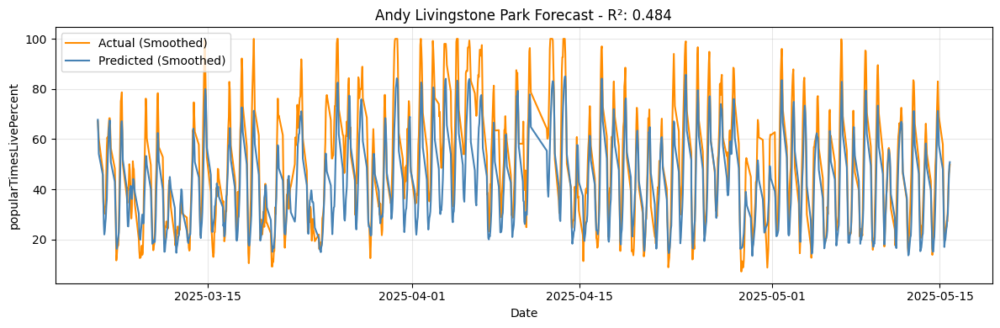

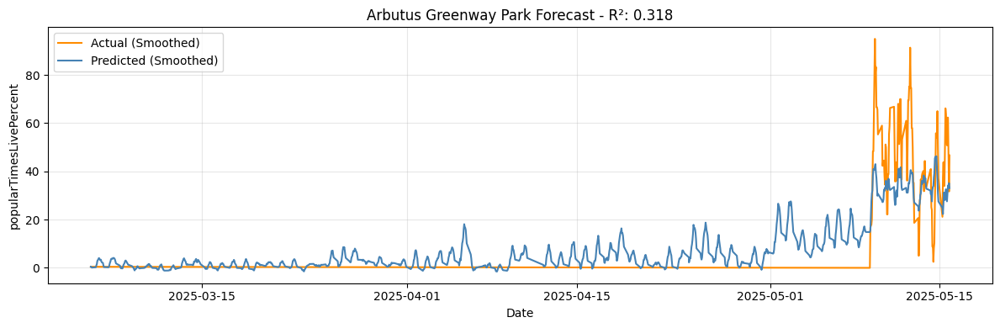

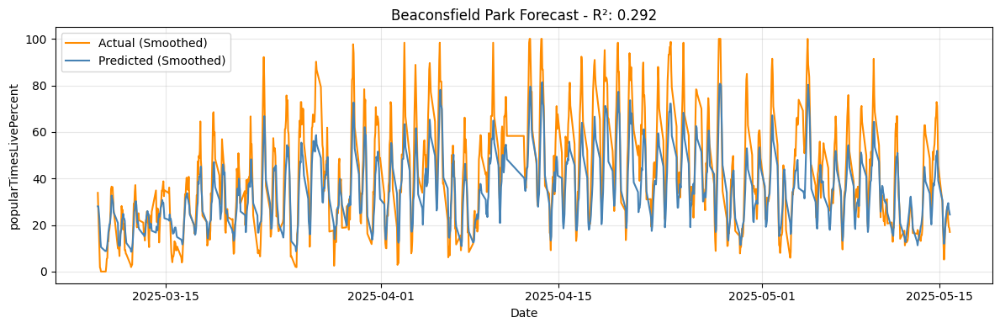

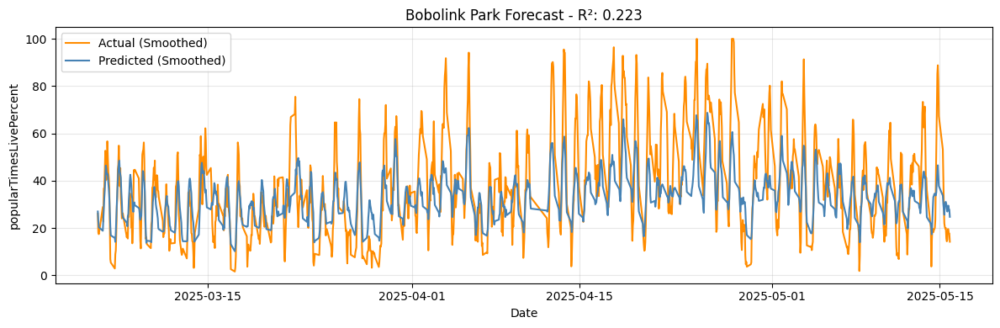

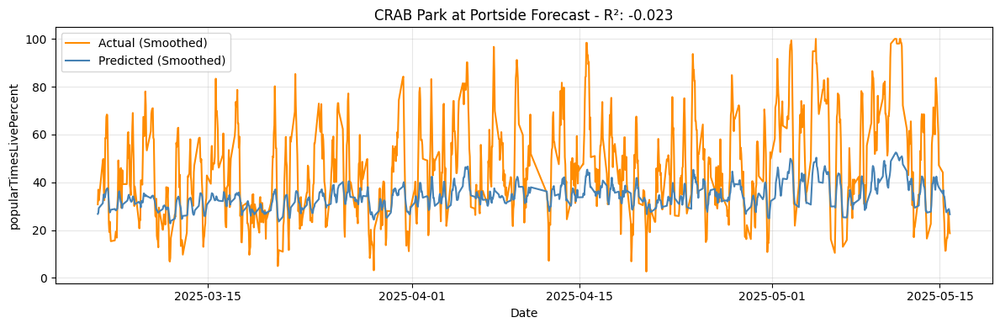

...

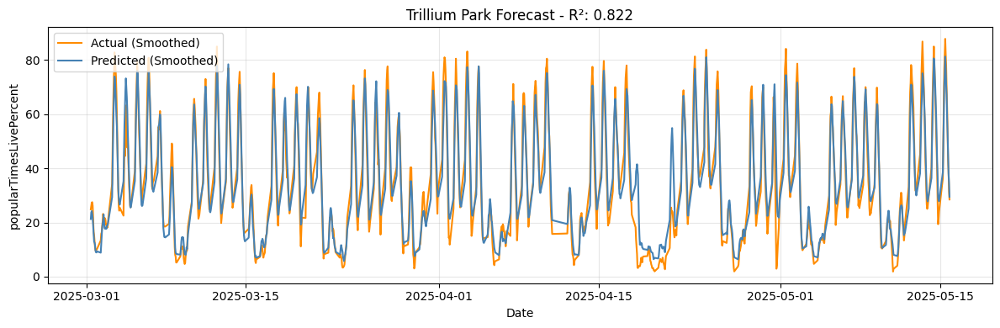

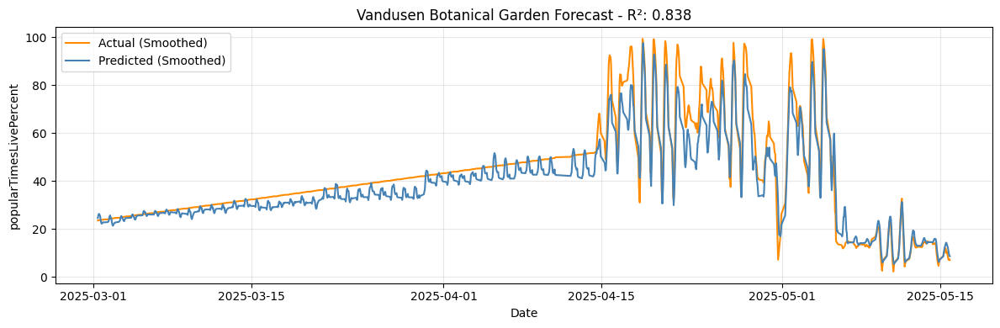

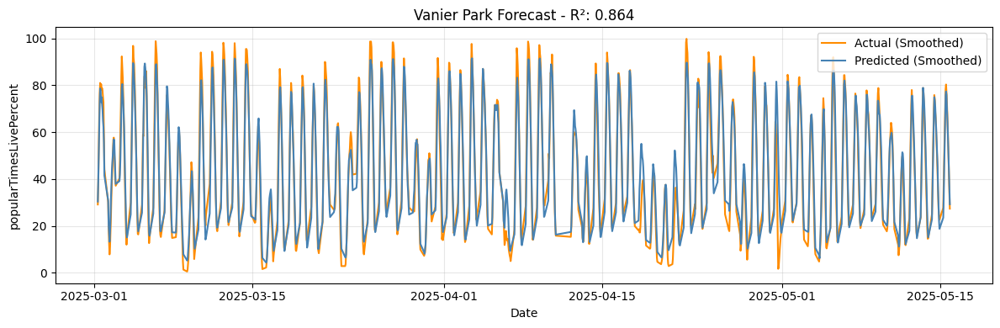

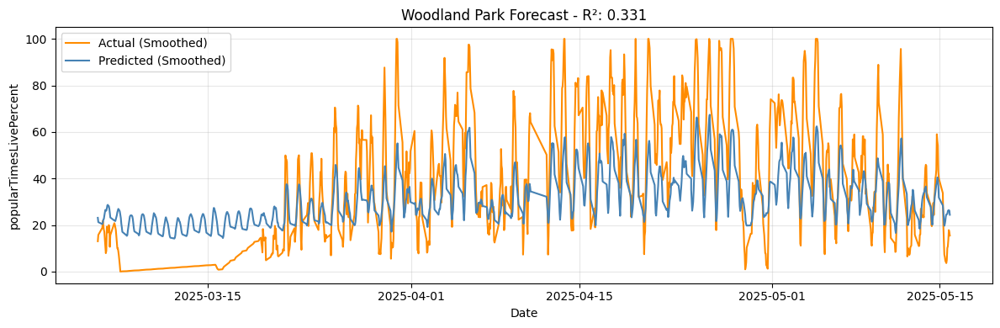

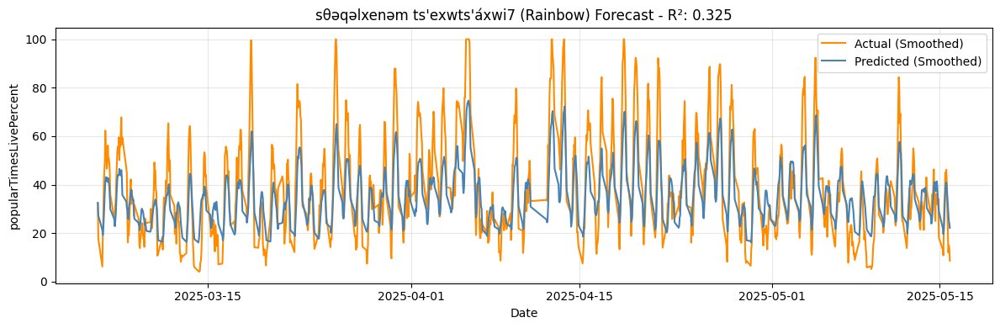

In [102]:
optimized_model = SimpleMultiParkLightGBM(final_merged_cleaned)
optimized_model.run_pipeline(optimize=True, n_trials=25)

# Model Comparison

Summary of Parameters

In [106]:
summary = []

for park in optimized_model.models.keys():
    # Baseline RMSE
    rmse_base = baseline_model.results[park]['metrics']['RMSE']
    
    # Optimized predictions
    actual = optimized_model.results[park]['actual']
    predicted = optimized_model.results[park]['predicted']
    
    # Optimized RMSE
    rmse_opt = np.sqrt(mean_squared_error(actual, predicted))
    
    # Improvement %
    improvement = 100 * (rmse_base - rmse_opt) / rmse_base

    # Extract hyperparameters if available
    model = optimized_model.models[park]
    hyperparams = model.get_params()

    summary.append({
        'Park': park,
        'Baseline_RMSE': rmse_base,
        'Optimized_RMSE': rmse_opt,
        'Improvement_%': improvement,
        'Params': {k: hyperparams[k] for k in sorted(hyperparams) if k in [
            'learning_rate', 'num_leaves', 'max_depth', 'feature_fraction', 
            'bagging_fraction', 'min_child_samples', 'reg_alpha', 'reg_lambda'
        ]}
    })

# Create summary DataFrame
summary_df = pd.DataFrame(summary).sort_values(by='Improvement_%', ascending=False).reset_index(drop=True)

# Display the full table
pd.set_option('display.max_colwidth', None)
pd.set_option('display.max_rows', None)
display(summary_df)


,Park,Baseline_RMSE,Optimized_RMSE,Improvement_%,Params
0,Queen Elizabeth Park,15.728443,10.254134,34.805158,"{'bagging_fraction': 0.6884216711083925, 'feature_fraction': 0.8090985711860921, 'learning_rate': 0.033574060669203945, 'max_depth': -1, 'min_child_samples': 91, 'num_leaves': 39, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
1,Arbutus Greenway Park,18.203314,15.986905,12.175854,"{'bagging_fraction': 0.9360924471965548, 'feature_fraction': 0.5032767815125836, 'learning_rate': 0.10323969903217037, 'max_depth': -1, 'min_child_samples': 87, 'num_leaves': 68, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
2,China Creek South Park,16.918993,15.604851,7.767259,"{'bagging_fraction': 0.5421601355179333, 'feature_fraction': 0.8609725954895489, 'learning_rate': 0.08942682333608534, 'max_depth': -1, 'min_child_samples': 42, 'num_leaves': 128, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
3,Hastings Park - Sanctuary,14.837238,14.083292,5.081443,"{'bagging_fraction': 0.6786542018267692, 'feature_fraction': 0.9974919958573519, 'learning_rate': 0.05054798827148077, 'max_depth': -1, 'min_child_samples': 62, 'num_leaves': 32, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
4,Columbia Park,38.860172,37.092655,4.548403,"{'bagging_fraction': 0.6960089244334193, 'feature_fraction': 0.9928402890152415, 'learning_rate': 0.23737428562461668, 'max_depth': -1, 'min_child_samples': 98, 'num_leaves': 143, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
5,Hastings Park - Italian Garden,14.837238,14.211759,4.215602,"{'bagging_fraction': 0.8098873034331733, 'feature_fraction': 0.8345631921091125, 'learning_rate': 0.09242287000180104, 'max_depth': -1, 'min_child_samples': 20, 'num_leaves': 22, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
6,Memorial South Park,20.074259,19.363275,3.541768,"{'bagging_fraction': 0.780577702843892, 'feature_fraction': 0.5606781931593691, 'learning_rate': 0.20175584206422853, 'max_depth': -1, 'min_child_samples': 90, 'num_leaves': 77, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
7,Oak Park,13.585387,13.152901,3.183467,"{'bagging_fraction': 0.8461523678245817, 'feature_fraction': 0.6679792184883704, 'learning_rate': 0.09661916352314276, 'max_depth': -1, 'min_child_samples': 40, 'num_leaves': 21, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
8,New Brighton Park,24.253575,23.497536,3.117228,"{'bagging_fraction': 0.5581110649630263, 'feature_fraction': 0.5652573146102036, 'learning_rate': 0.0502554735231304, 'max_depth': -1, 'min_child_samples': 57, 'num_leaves': 91, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"
9,General Brock Park,37.928237,36.780306,3.026587,"{'bagging_fraction': 0.5041487761991297, 'feature_fraction': 0.808374903418935, 'learning_rate': 0.019738144192024853, 'max_depth': -1, 'min_child_samples': 39, 'num_leaves': 82, 'reg_alpha': 0.0, 'reg_lambda': 0.0}"


Summary of Metrics Comparison

In [ ]:
comparison = []

for park in optimized_model.models.keys():
    # Baseline metrics
    base_metrics = baseline_model.results[park]['metrics']
    rmse_base = base_metrics['RMSE']
    mae_base = base_metrics['MAE']
    r2_base = base_metrics['R2']
    
    # Optimized predictions and metrics
    y_true = optimized_model.results[park]['actual']
    y_pred = optimized_model.results[park]['predicted']
    
    rmse_opt = mean_squared_error(y_true, y_pred) ** 0.5
    mae_opt = mean_absolute_error(y_true, y_pred)
    r2_opt = r2_score(y_true, y_pred)

    # Model performance comparison
    better_model = 'Optimized' if rmse_opt < rmse_base else 'Baseline'
    improvement = 100 * (rmse_base - rmse_opt) / rmse_base

    # Append to summary
    comparison.append({
        'Park': park,
        'Baseline_RMSE': round(rmse_base, 3),
        'Optimized_RMSE': round(rmse_opt, 3),
        'Baseline_MAE': round(mae_base, 3),
        'Optimized_MAE': round(mae_opt, 3),
        'Baseline_R2': round(r2_base, 3),
        'Optimized_R2': round(r2_opt, 3),
        'Improvement_%': round(improvement, 2),
        'Better_Model': better_model,
    })

# Create DataFrame
comparison_df = pd.DataFrame(comparison).sort_values(by='Improvement_%', ascending=False).reset_index(drop=True)

# Show the table
display(comparison_df)


,Park,Baseline_RMSE,Optimized_RMSE,Baseline_MAE,Optimized_MAE,Baseline_R2,Optimized_R2,Improvement_%,Better_Model
0,Queen Elizabeth Park,15.728,10.254,12.649,7.302,0.686,0.867,34.81,Optimized
1,Arbutus Greenway Park,18.203,15.987,9.562,8.352,0.116,0.318,12.18,Optimized
2,China Creek South Park,16.919,15.605,11.062,8.295,0.184,0.306,7.77,Optimized
3,Hastings Park - Sanctuary,14.837,14.083,10.416,9.632,0.666,0.699,5.08,Optimized
4,Columbia Park,38.860,37.093,29.615,28.560,0.161,0.235,4.55,Optimized
5,Hastings Park - Italian Garden,14.837,14.212,10.416,9.658,0.666,0.693,4.22,Optimized
6,Memorial South Park,20.074,19.363,15.325,14.725,0.663,0.686,3.54,Optimized
7,Oak Park,13.585,13.153,9.489,9.198,0.809,0.821,3.18,Optimized
8,New Brighton Park,24.254,23.498,18.850,18.629,0.356,0.396,3.12,Optimized
9,General Brock Park,37.928,36.780,33.093,32.095,0.022,0.080,3.03,Optimized


In [ ]:
# Assess The Overfitting/Underfitting 
# from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
# import numpy as np

# train_summary = []

# for park in pipeline.results.keys():
#     model = pipeline.models[park]
    
#     # Filter the original data for this park
#     park_data = pipeline.df[pipeline.df[pipeline.park_col] == park]
#     split = int(len(park_data) * (1 - 0.2))  # Use same split logic as pipeline
#     train = park_data.iloc[:split]
    
#     all_features = (
#         pipeline.exog_features +
#         pipeline.time_features +
#         pipeline.lag_features +
#         ['park_encoded']
#     )
    
#     X_train = train[all_features]
#     y_train = train[pipeline.target_col]
    
#     # Predict on train data
#     train_preds = model.predict(X_train)
    
#     # Calculate metrics
#     mae = mean_absolute_error(y_train, train_preds)
#     rmse = np.sqrt(mean_squared_error(y_train, train_preds))
#     r2 = r2_score(y_train, train_preds)
    
#     # Compare with test
#     test_metrics = pipeline.results[park]['metrics']
#     overfit_gap = test_metrics['RMSE'] - rmse
    
#     train_summary.append({
#         'Park': park,
#         'Train_MAE': mae,
#         'Train_RMSE': rmse,
#         'Train_R2': r2,
#         'Test_MAE': test_metrics['MAE'],
#         'Test_RMSE': test_metrics['RMSE'],
#         'Test_R2': test_metrics['R2'],
#         'Overfit_Gap': overfit_gap
#     })

# # Convert to DataFrame
# train_summary_df = pd.DataFrame(train_summary).sort_values(by='Overfit_Gap', ascending=False).reset_index(drop=True)


# Forecasting Future Value

In [111]:
selected_park = 'Queen Elizabeth Park'
model = optimized_model.models[selected_park]

In [ ]:
recent_data = optimized_model.df[optimized_model.df[optimized_model.park_col] == selected_park].copy()
recent_data = recent_data.sort_index()
last_known = recent_data.tail(34)  


In [117]:
last_known.head()

,park_name,popularTimesLivePercent,temp,precip_rain,precip_snow,is_holiday,is_weekend,has_event,hour,hour_op,day_of_week,month,hour_sin,hour_cos,lag_1,lag_2,lag_3,lag_17,park_encoded
date_rounded,,,,,,,,,,,,,,,,,,,
2025-05-14 06:00:00,Queen Elizabeth Park,3.0,10.1,0,0,0,0,0,6,0,2,5,0.000000,1.000000,18.112816,20.000000,37.000000,4.0,46
2025-05-14 07:00:00,Queen Elizabeth Park,6.0,9.8,0,0,0,0,0,7,1,2,5,0.361242,0.932472,3.000000,18.112816,20.000000,6.0,46
2025-05-14 08:00:00,Queen Elizabeth Park,9.0,10.8,0,0,0,0,0,8,2,2,5,0.673696,0.739009,6.000000,3.000000,18.112816,11.0,46
2025-05-14 09:00:00,Queen Elizabeth Park,20.0,11.4,0,0,0,0,0,9,3,2,5,0.895163,0.445738,9.000000,6.000000,3.000000,21.0,46
2025-05-14 10:00:00,Queen Elizabeth Park,26.0,11.9,0,0,0,0,0,10,4,2,5,0.995734,0.092268,20.000000,9.000000,6.000000,24.0,46


In [116]:
last_known.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 34 entries, 2025-05-14 06:00:00 to 2025-05-15 22:00:00
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   park_name                34 non-null     object 
 1   popularTimesLivePercent  34 non-null     float64
 2   temp                     34 non-null     float64
 3   precip_rain              34 non-null     int64  
 4   precip_snow              34 non-null     int64  
 5   is_holiday               34 non-null     int64  
 6   is_weekend               34 non-null     int64  
 7   has_event                34 non-null     int64  
 8   hour                     34 non-null     int32  
 9   hour_op                  34 non-null     int32  
 10  day_of_week              34 non-null     int32  
 11  month                    34 non-null     int32  
 12  hour_sin                 34 non-null     float64
 13  hour_cos                 34 non-null     flo